In [2]:
import tensorflow as tf
import tensorflow_hub as hub
import numpy as np
import pandas as pd
import glob
import nltk

import itertools
from textblob import TextBlob
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
import chart_studio.plotly as py
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA

import scipy.cluster.hierarchy as shc
from sklearn.cluster import AgglomerativeClustering

import gensim.models.word2vec as w2v
from sklearn.manifold import TSNE
import plotly.express as px

from collections import defaultdict
from scipy.cluster.hierarchy import dendrogram, set_link_color_palette
from fastcluster import linkage
from matplotlib.colors import rgb2hex, colorConverter

In [3]:
all_files=glob.glob("/Users/tanyachauhan/Documents/Diksha_All_Csv/"+"/*.csv")
dflist = []


In [4]:
for filename in all_files:
    # Dataframe of one file
    df_sm = pd.read_csv(filename, index_col=None, header=0)
    dflist.append(df_sm)
    
df = pd.concat(dflist, axis=0, ignore_index=True)


In [5]:
df.dropna(subset=["Review Text"],inplace=True)


In [6]:
df

,Package Name,App Version Code,App Version Name,Reviewer Language,Device,Review Submit Date and Time,Review Submit Millis Since Epoch,Review Last Update Date and Time,Review Last Update Millis Since Epoch,Star Rating,Review Title,Review Text,Developer Reply Date and Time,Developer Reply Millis Since Epoch,Developer Reply Text,Review Link
2,in.gov.diksha.app,NaN,NaN,en,vivaltods5m,2020-01-01T03:16:15Z,1577848575284,2020-01-01T03:16:15Z,1577848575284,3,NaN,good but not much,2020-01-08T08:22:10Z,1.578472e+12,"Hi Anvesh, we didn't hear back from you. You c...",https://play.google.com/apps/publish?account=8...
7,in.gov.diksha.app,51.0,2.5.183,en,violet,2020-01-01T07:23:49Z,1577863429433,2020-01-01T07:23:49Z,1577863429433,3,NaN,Good application,2020-01-02T04:04:06Z,1.577938e+12,"Hi Vasant, thanks for reviewing us. If you lik...",https://play.google.com/apps/publish?account=8...
8,in.gov.diksha.app,51.0,2.5.183,en,1902,2020-01-01T07:33:23Z,1577864003055,2020-01-01T07:33:23Z,1577864003055,5,NaN,Nice explanation,2020-01-01T08:00:08Z,1.577866e+12,Hi! Thanks for your feedback. We're delighted ...,https://play.google.com/apps/publish?account=8...
11,in.gov.diksha.app,51.0,2.5.183,hi,Z50,2020-01-01T09:37:13Z,1577871433991,2020-01-01T09:37:13Z,1577871433991,5,NaN,Nice app,2020-01-01T10:00:08Z,1.577873e+12,Hi! Thanks for the 5 star rating. Hope you con...,https://play.google.com/apps/publish?account=8...
12,in.gov.diksha.app,51.0,2.5.183,en,CPH1859,2020-01-01T09:37:46Z,1577871466601,2020-01-01T09:37:46Z,1577871466601,5,NaN,Best app 4 students,2020-01-01T10:00:08Z,1.577873e+12,Hi! Thanks for your feedback. We're delighted ...,https://play.google.com/apps/publish?account=8...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24748,in.gov.diksha.app,NaN,NaN,en,riva,2019-09-30T17:11:10Z,1569863470077,2019-09-30T17:11:10Z,1569863470077,3,NaN,Sadanand Kushwaha,2019-10-01T04:24:44Z,1.569904e+12,"Dear Kamlesh, thank you for the rating usPleas...",https://play.google.com/apps/publish?account=8...
24749,in.gov.diksha.app,44.0,2.3.133,en,TECNO-ID3k,2019-09-30T17:13:02Z,1569863582573,2019-09-30T17:13:02Z,1569863582573,4,NaN,I am a student . It is very good app but its p...,2019-10-04T05:34:54Z,1.570167e+12,"Hi Abhishek, please share the requested detail...",https://play.google.com/apps/publish?account=8...
24750,in.gov.diksha.app,44.0,2.3.133,en,santoni,2019-09-30T17:17:35Z,1569863855829,2019-09-30T17:17:35Z,1569863855829,5,NaN,Well app,2019-09-30T17:30:10Z,1.569865e+12,Hi! Thanks for the 5 star rating. Hope you con...,https://play.google.com/apps/publish?account=8...
24751,in.gov.diksha.app,38.0,2.1.109,en,GIONEE_WBL7519,2019-09-30T17:39:16Z,1569865156577,2019-09-30T17:39:16Z,1569865156577,5,NaN,Nice video,2019-09-30T18:00:11Z,1.569866e+12,Hi! Thanks for your feedback. We're delighted ...,https://play.google.com/apps/publish?account=8...


In [7]:
eng_data = df.loc[df['Reviewer Language']=='en']
eng_df = pd.DataFrame(eng_data)
# eng_df

In [8]:
eng_df.reset_index(inplace = True) 


In [11]:
eng_df 


,index,Package Name,App Version Code,App Version Name,Reviewer Language,Device,Review Submit Date and Time,Review Submit Millis Since Epoch,Review Last Update Date and Time,Review Last Update Millis Since Epoch,Star Rating,Review Title,Review Text,Developer Reply Date and Time,Developer Reply Millis Since Epoch,Developer Reply Text,Review Link
0,2,in.gov.diksha.app,NaN,NaN,en,vivaltods5m,2020-01-01T03:16:15Z,1577848575284,2020-01-01T03:16:15Z,1577848575284,3,NaN,good but not much,2020-01-08T08:22:10Z,1.578472e+12,"Hi Anvesh, we didn't hear back from you. You c...",https://play.google.com/apps/publish?account=8...
1,7,in.gov.diksha.app,51.0,2.5.183,en,violet,2020-01-01T07:23:49Z,1577863429433,2020-01-01T07:23:49Z,1577863429433,3,NaN,Good application,2020-01-02T04:04:06Z,1.577938e+12,"Hi Vasant, thanks for reviewing us. If you lik...",https://play.google.com/apps/publish?account=8...
2,8,in.gov.diksha.app,51.0,2.5.183,en,1902,2020-01-01T07:33:23Z,1577864003055,2020-01-01T07:33:23Z,1577864003055,5,NaN,Nice explanation,2020-01-01T08:00:08Z,1.577866e+12,Hi! Thanks for your feedback. We're delighted ...,https://play.google.com/apps/publish?account=8...
3,12,in.gov.diksha.app,51.0,2.5.183,en,CPH1859,2020-01-01T09:37:46Z,1577871466601,2020-01-01T09:37:46Z,1577871466601,5,NaN,Best app 4 students,2020-01-01T10:00:08Z,1.577873e+12,Hi! Thanks for your feedback. We're delighted ...,https://play.google.com/apps/publish?account=8...
4,15,in.gov.diksha.app,NaN,NaN,en,G2199,2020-01-01T10:40:39Z,1577875239740,2020-01-01T10:40:39Z,1577875239740,2,NaN,ok,2020-01-02T04:04:51Z,1.577938e+12,"Hi Chandrasekar, we regret the inconvenience c...",https://play.google.com/apps/publish?account=8...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11849,24748,in.gov.diksha.app,NaN,NaN,en,riva,2019-09-30T17:11:10Z,1569863470077,2019-09-30T17:11:10Z,1569863470077,3,NaN,Sadanand Kushwaha,2019-10-01T04:24:44Z,1.569904e+12,"Dear Kamlesh, thank you for the rating usPleas...",https://play.google.com/apps/publish?account=8...
11850,24749,in.gov.diksha.app,44.0,2.3.133,en,TECNO-ID3k,2019-09-30T17:13:02Z,1569863582573,2019-09-30T17:13:02Z,1569863582573,4,NaN,I am a student . It is very good app but its p...,2019-10-04T05:34:54Z,1.570167e+12,"Hi Abhishek, please share the requested detail...",https://play.google.com/apps/publish?account=8...
11851,24750,in.gov.diksha.app,44.0,2.3.133,en,santoni,2019-09-30T17:17:35Z,1569863855829,2019-09-30T17:17:35Z,1569863855829,5,NaN,Well app,2019-09-30T17:30:10Z,1.569865e+12,Hi! Thanks for the 5 star rating. Hope you con...,https://play.google.com/apps/publish?account=8...
11852,24751,in.gov.diksha.app,38.0,2.1.109,en,GIONEE_WBL7519,2019-09-30T17:39:16Z,1569865156577,2019-09-30T17:39:16Z,1569865156577,5,NaN,Nice video,2019-09-30T18:00:11Z,1.569866e+12,Hi! Thanks for your feedback. We're delighted ...,https://play.google.com/apps/publish?account=8...


In [213]:
from nltk.corpus import stopwords
stopwords = stopwords.words('english')
import re

def leaves(tree):
    """Finds NP (nounphrase) leaf nodes of a chunk tree."""
    for subtree in tree.subtrees(filter = lambda t: t.label()=='NP'):
       # The yield statement suspends function’s execution and sends a value back to the caller.
        yield subtree.leaves()

def acceptable_word(word):
    """Checks conditions for acceptable word: length, stopword."""
    accepted = bool(2 <= len(word) <= 40
                    and word.lower() not in stopwords)
    return accepted

def get_terms(tree):

    for leaf in leaves(tree):
        term = [ w for w,t in leaf if acceptable_word(w) ]
        yield term


In [214]:
grammar =r"""
  NP: {<DT|JJ|NN.*>+}          
  PP: {<IN><NP>}            
  VP: {<VB.*><NP|PP|CLAUSE>+$}
  CLAUSE: {<NP><VP>}          
  """
      
    

In [215]:
def phrase_extraction(text, grammar):
    text = text.lower()
    sentence_re = r'''(?x)          
      (?:[A-Z]\.)+        
    | \w+(?:-\w+)*        
    | \$?\d+(?:\.\d+)?%?  
    | \.\.\.              
    | [][.,;"'?():_`-]    
    '''
    
    ls = [] 
    word_token_ls = text.split(" ")

    toks = nltk.regexp_tokenize(text, sentence_re)
    postoks = nltk.tag.pos_tag(toks)
    
    chunker = nltk.RegexpParser(grammar)
    
    tree = chunker.parse(postoks)
    terms = get_terms(tree)
    for term in terms:
        ls.append(" ".join(term)) 
    return list(set(ls))



In [17]:
ls= list(eng_df["Review Text"])
print(ls)

['good but not much', 'Good application', 'Nice explanation', 'Best app 4 students', 'ok', 'Excellent', 'Ok', 'This app very usefull for students and teachers', 'Good', 'Wow amazing', 'Not working on mobile even its android 7.3', 'Very very bad app👿👿😡😡😠😠😤😤', 'Easy to learn', 'Excellent', 'Very good app. I am a secondary school teacher, & I notice dixa doing smart work.... I would like to do my little contribute...', 'It is very useful', 'This is very importent for studes', 'Excellent', 'Unique', 'It is a good app for leaning', 'It is very helpful to us', 'Super teaching', 'How to use it all book are in marathi or Gujarat l had all in English language Please', '👌👌', 'good application', 'Informative app with loads of learning materials specially for teachers who wants to enhance their knowledge.', 'Very good app', 'This app is a great help to learn maths.It is extraordinary.', 'The app is very useful to you and all students', 'This app very helpful for students and teachers..', 'Useful l

In [18]:
out = map(lambda x:x.lower(), ls)  
review_text_lower = list(out)
review_text_lower

['good but not much',
 'good application',
 'nice explanation',
 'best app 4 students',
 'ok',
 'excellent',
 'ok',
 'this app very usefull for students and teachers',
 'good',
 'wow amazing',
 'not working on mobile even its android 7.3',
 'very very bad app👿👿😡😡😠😠😤😤',
 'easy to learn',
 'excellent',
 'very good app. i am a secondary school teacher, & i notice dixa doing smart work.... i would like to do my little contribute...',
 'it is very useful',
 'this is very importent for studes',
 'excellent',
 'unique',
 'it is a good app for leaning',
 'it is very helpful to us',
 'super teaching',
 'how to use it all book are in marathi or gujarat l had all in english language please',
 '👌👌',
 'good application',
 'informative app with loads of learning materials specially for teachers who wants to enhance their knowledge.',
 'very good app',
 'this app is a great help to learn maths.it is extraordinary.',
 'the app is very useful to you and all students',
 'this app very helpful for studen

In [19]:
# Numbers removing

import re
review_text_lower_wdoutno = list(map(lambda x: re.sub(r'\d+', '', x), review_text_lower)) 
review_text_lower_wdoutno


['good but not much',
 'good application',
 'nice explanation',
 'best app  students',
 'ok',
 'excellent',
 'ok',
 'this app very usefull for students and teachers',
 'good',
 'wow amazing',
 'not working on mobile even its android .',
 'very very bad app👿👿😡😡😠😠😤😤',
 'easy to learn',
 'excellent',
 'very good app. i am a secondary school teacher, & i notice dixa doing smart work.... i would like to do my little contribute...',
 'it is very useful',
 'this is very importent for studes',
 'excellent',
 'unique',
 'it is a good app for leaning',
 'it is very helpful to us',
 'super teaching',
 'how to use it all book are in marathi or gujarat l had all in english language please',
 '👌👌',
 'good application',
 'informative app with loads of learning materials specially for teachers who wants to enhance their knowledge.',
 'very good app',
 'this app is a great help to learn maths.it is extraordinary.',
 'the app is very useful to you and all students',
 'this app very helpful for students 

In [20]:
# Remove punctuation
import string
def remove_punctuation(text): 
    translator = str.maketrans('', '', string.punctuation) 
    return text.translate(translator) 

review_text_wdout_punct = []
for i in review_text_lower_wdoutno:
    x = remove_punctuation(i)
    review_text_wdout_punct.append(x)
review_text_wdout_punct   


['good but not much',
 'good application',
 'nice explanation',
 'best app  students',
 'ok',
 'excellent',
 'ok',
 'this app very usefull for students and teachers',
 'good',
 'wow amazing',
 'not working on mobile even its android ',
 'very very bad app👿👿😡😡😠😠😤😤',
 'easy to learn',
 'excellent',
 'very good app i am a secondary school teacher  i notice dixa doing smart work i would like to do my little contribute',
 'it is very useful',
 'this is very importent for studes',
 'excellent',
 'unique',
 'it is a good app for leaning',
 'it is very helpful to us',
 'super teaching',
 'how to use it all book are in marathi or gujarat l had all in english language please',
 '👌👌',
 'good application',
 'informative app with loads of learning materials specially for teachers who wants to enhance their knowledge',
 'very good app',
 'this app is a great help to learn mathsit is extraordinary',
 'the app is very useful to you and all students',
 'this app very helpful for students and teachers',

In [21]:
# remove whitespace from text 
def remove_whitespace(text): 
    return " ".join(text.split()) 

review_text_wdout_whitespace = []
for i in review_text_wdout_punct:
    x = remove_whitespace(i)
    review_text_wdout_whitespace.append(x)
review_text_wdout_whitespace  


['good but not much',
 'good application',
 'nice explanation',
 'best app students',
 'ok',
 'excellent',
 'ok',
 'this app very usefull for students and teachers',
 'good',
 'wow amazing',
 'not working on mobile even its android',
 'very very bad app👿👿😡😡😠😠😤😤',
 'easy to learn',
 'excellent',
 'very good app i am a secondary school teacher i notice dixa doing smart work i would like to do my little contribute',
 'it is very useful',
 'this is very importent for studes',
 'excellent',
 'unique',
 'it is a good app for leaning',
 'it is very helpful to us',
 'super teaching',
 'how to use it all book are in marathi or gujarat l had all in english language please',
 '👌👌',
 'good application',
 'informative app with loads of learning materials specially for teachers who wants to enhance their knowledge',
 'very good app',
 'this app is a great help to learn mathsit is extraordinary',
 'the app is very useful to you and all students',
 'this app very helpful for students and teachers',
 '

In [22]:
# convert a list to string    
def listToString(s):  
    str1 = ""   
    for ele in s:  
        str1 += ele   
        str1 += ' '
    return str1  
        

In [23]:
from nltk.corpus import stopwords 
from nltk.tokenize import word_tokenize 
  
# remove stopwords function 
def remove_stopwords(text): 
    stop_words = list(stopwords.words("english")) 
    word_tokens = word_tokenize(text) 
    filtered_text = [word for word in word_tokens if word not in stop_words] 
    return filtered_text 
  
review_text_wdout_stopwords = []
for i in review_text_wdout_whitespace:
    x = remove_stopwords(i)
    y = listToString(x)
    review_text_wdout_stopwords.append(y)
review_text_wdout_stopwords  

['good much ',
 'good application ',
 'nice explanation ',
 'best app students ',
 'ok ',
 'excellent ',
 'ok ',
 'app usefull students teachers ',
 'good ',
 'wow amazing ',
 'working mobile even android ',
 'bad app👿👿😡😡😠😠😤😤 ',
 'easy learn ',
 'excellent ',
 'good app secondary school teacher notice dixa smart work would like little contribute ',
 'useful ',
 'importent studes ',
 'excellent ',
 'unique ',
 'good app leaning ',
 'helpful us ',
 'super teaching ',
 'use book marathi gujarat l english language please ',
 '👌👌 ',
 'good application ',
 'informative app loads learning materials specially teachers wants enhance knowledge ',
 'good app ',
 'app great help learn mathsit extraordinary ',
 'app useful students ',
 'app helpful students teachers ',
 'useful learning every one ',
 'good aap understand much 😕😒👽 ',
 'use full ',
 'cant able see video scanned qr code many times video displaying ',
 'excellent app teachers students ',
 'tried child st standard ssc board contents ful

In [24]:
# remove emoji
def deEmojify(inputString):
    return inputString.encode('ascii', 'ignore').decode('ascii')

review_text_wdout_emojis = []
for i in review_text_wdout_stopwords:
    x = deEmojify(i)
    review_text_wdout_emojis.append(x)
review_text_wdout_emojis  

['good much ',
 'good application ',
 'nice explanation ',
 'best app students ',
 'ok ',
 'excellent ',
 'ok ',
 'app usefull students teachers ',
 'good ',
 'wow amazing ',
 'working mobile even android ',
 'bad app ',
 'easy learn ',
 'excellent ',
 'good app secondary school teacher notice dixa smart work would like little contribute ',
 'useful ',
 'importent studes ',
 'excellent ',
 'unique ',
 'good app leaning ',
 'helpful us ',
 'super teaching ',
 'use book marathi gujarat l english language please ',
 ' ',
 'good application ',
 'informative app loads learning materials specially teachers wants enhance knowledge ',
 'good app ',
 'app great help learn mathsit extraordinary ',
 'app useful students ',
 'app helpful students teachers ',
 'useful learning every one ',
 'good aap understand much  ',
 'use full ',
 'cant able see video scanned qr code many times video displaying ',
 'excellent app teachers students ',
 'tried child st standard ssc board contents fully available 

In [25]:
# lemmatization
from nltk.stem import WordNetLemmatizer 
from nltk.tokenize import word_tokenize 
lemmatizer = WordNetLemmatizer() 

# lemmatize string 
def lemmatize_word(text): 
    word_tokens = word_tokenize(text) 
    # provide context i.e. part-of-speech 
    lemmas = [lemmatizer.lemmatize(word, pos ='v') for word in word_tokens] 
    return lemmas 
  
review_text_lemmas = []
for i in review_text_wdout_emojis:
    x = lemmatize_word(i)
    y = listToString(x)
    review_text_lemmas.append(y)
review_text_lemmas  

['good much ',
 'good application ',
 'nice explanation ',
 'best app students ',
 'ok ',
 'excellent ',
 'ok ',
 'app usefull students teachers ',
 'good ',
 'wow amaze ',
 'work mobile even android ',
 'bad app ',
 'easy learn ',
 'excellent ',
 'good app secondary school teacher notice dixa smart work would like little contribute ',
 'useful ',
 'importent stud ',
 'excellent ',
 'unique ',
 'good app lean ',
 'helpful us ',
 'super teach ',
 'use book marathi gujarat l english language please ',
 '',
 'good application ',
 'informative app load learn materials specially teachers want enhance knowledge ',
 'good app ',
 'app great help learn mathsit extraordinary ',
 'app useful students ',
 'app helpful students teachers ',
 'useful learn every one ',
 'good aap understand much ',
 'use full ',
 'cant able see video scan qr code many time video display ',
 'excellent app teachers students ',
 'try child st standard ssc board content fully available poetry songs app text book differ

In [26]:
# remove review text containing less than 3 words using regex (findall()) 

import re 

processed_review_text = []
for i in review_text_lemmas:
    res = len(re.findall(r'\w+', i)) 
    if(res>=3):
        processed_review_text.append(i)
        
processed_review_text    

['best app students ',
 'app usefull students teachers ',
 'work mobile even android ',
 'good app secondary school teacher notice dixa smart work would like little contribute ',
 'good app lean ',
 'use book marathi gujarat l english language please ',
 'informative app load learn materials specially teachers want enhance knowledge ',
 'app great help learn mathsit extraordinary ',
 'app useful students ',
 'app helpful students teachers ',
 'useful learn every one ',
 'good aap understand much ',
 'cant able see video scan qr code many time video display ',
 'excellent app teachers students ',
 'try child st standard ssc board content fully available poetry songs app text book different interactive level require effective ',
 'studentcontent come sad ',
 'helfull teacher students ',
 'hi sir use old versions android mobile support please update ',
 'imp useful app ',
 'know reason content standard need ',
 'good interest helpful app free help teach lesson ',
 'truly helpful better st

In [27]:
# Vectorization

def vectorization_of_list(input_list):
    #word embedding(vectorization)
    embed = hub.Module("/Users/tanyachauhan/Downloads/3")
    tf.logging.set_verbosity(tf.logging.ERROR)
    with tf.Session() as session:
        session.run([tf.global_variables_initializer(), tf.tables_initializer()])
        message_embeddings = session.run(embed(input_list))
#         print(message_embeddings)
        lst = []
        for i in message_embeddings:
            df = pd.DataFrame([i])
            lst.append(df)
    frame = pd.concat(lst)
    return frame

In [28]:
vectorized_review_frame = vectorization_of_list(processed_review_text)
vectorized_review_frame

,0,1,2,3,4,5,6,7,8,9,...,502,503,504,505,506,507,508,509,510,511
0,0.014989,-0.054360,0.044410,-0.013166,-0.078643,0.012875,0.020251,0.066570,-0.014012,-0.029315,...,-0.115929,-0.056953,0.008988,-0.044505,0.008775,0.019881,-0.014857,-0.042894,-0.004678,-0.006225
0,0.014371,-0.028846,0.044812,-0.009669,-0.067728,0.013394,0.009333,0.035425,-0.036611,-0.005325,...,-0.087885,-0.025638,0.006957,-0.075377,0.015189,-0.025097,0.025509,-0.057867,0.012289,0.042848
0,0.011090,-0.047363,0.073098,-0.022431,-0.034471,0.003516,0.065954,0.020301,-0.045378,0.022051,...,-0.030737,-0.051063,-0.029952,0.011110,0.003257,0.040687,-0.026417,-0.057769,-0.057126,0.003666
0,0.021578,-0.004523,0.026648,0.006459,-0.074257,-0.050447,-0.022495,0.000103,-0.034196,0.010375,...,-0.109561,-0.029006,0.015602,-0.019132,0.021640,0.016368,0.044480,-0.061311,0.037686,0.050024
0,-0.006026,0.009414,-0.046563,-0.027482,-0.018227,-0.014290,0.085160,0.046961,-0.049250,0.015450,...,-0.046057,-0.060354,-0.027073,-0.013925,0.032545,-0.014851,-0.031157,-0.054522,0.064729,0.021328
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,0.013094,-0.011124,0.028710,-0.003136,-0.033803,-0.014707,0.032590,-0.011652,-0.061524,-0.000224,...,-0.075251,-0.023764,-0.019472,-0.029827,-0.042949,0.009757,-0.038272,-0.072789,0.048858,0.029099
0,0.033896,-0.034740,-0.022136,-0.064314,-0.046638,0.061058,0.001692,-0.034511,-0.087365,0.018782,...,0.001034,0.082173,0.026416,-0.092130,-0.000149,-0.001710,-0.048512,0.065872,-0.045558,0.072652
0,0.008500,0.030200,0.049134,-0.025467,-0.085026,-0.017218,0.055356,0.019804,-0.029367,0.008584,...,-0.121194,-0.015772,-0.009413,-0.044664,0.001766,-0.003201,-0.037143,-0.022002,-0.015377,0.019788
0,0.019529,0.019542,0.018748,0.008598,0.028014,0.028087,0.035552,0.040886,-0.036404,-0.027234,...,-0.095281,-0.046992,-0.019544,-0.016195,0.062742,-0.034503,-0.028392,-0.068943,0.026721,-0.035732


In [105]:
prob=['poor video quality','download problem','content not available','scanning problem','video availability problem']
for i in range(len(prob)):
    prob[i]=prob[i].lower()
print(prob)

['poor video quality', 'download problem', 'content not available', 'scanning problem', 'video availability problem']


In [30]:
def vectorization_of_list(input_list):
    #word embedding(vectorization)
    embed = hub.Module("/Users/tanyachauhan/Downloads/3")
    tf.logging.set_verbosity(tf.logging.ERROR)
    with tf.Session() as session:
        session.run([tf.global_variables_initializer(), tf.tables_initializer()])
        message_embeddings = session.run(embed(input_list))
#         print(message_embeddings)
        lst = []
        for i in message_embeddings:
            df = pd.DataFrame([i])
            lst.append(df)
    frame = pd.concat(lst)
    return frame

In [168]:
# vectorized_review_frame.loc[0]

In [99]:
vectorized_review_frame.index=processed_review_text    


In [100]:
vectorized_review_frame

,0,1,2,3,4,5,6,7,8,9,...,502,503,504,505,506,507,508,509,510,511
best app students,0.014989,-0.054360,0.044410,-0.013166,-0.078643,0.012875,0.020251,0.066570,-0.014012,-0.029315,...,-0.115929,-0.056953,0.008988,-0.044505,0.008775,0.019881,-0.014857,-0.042894,-0.004678,-0.006225
app usefull students teachers,0.014371,-0.028846,0.044812,-0.009669,-0.067728,0.013394,0.009333,0.035425,-0.036611,-0.005325,...,-0.087885,-0.025638,0.006957,-0.075377,0.015189,-0.025097,0.025509,-0.057867,0.012289,0.042848
work mobile even android,0.011090,-0.047363,0.073098,-0.022431,-0.034471,0.003516,0.065954,0.020301,-0.045378,0.022051,...,-0.030737,-0.051063,-0.029952,0.011110,0.003257,0.040687,-0.026417,-0.057769,-0.057126,0.003666
good app secondary school teacher notice dixa smart work would like little contribute,0.021578,-0.004523,0.026648,0.006459,-0.074257,-0.050447,-0.022495,0.000103,-0.034196,0.010375,...,-0.109561,-0.029006,0.015602,-0.019132,0.021640,0.016368,0.044480,-0.061311,0.037686,0.050024
good app lean,-0.006026,0.009414,-0.046563,-0.027482,-0.018227,-0.014290,0.085160,0.046961,-0.049250,0.015450,...,-0.046057,-0.060354,-0.027073,-0.013925,0.032545,-0.014851,-0.031157,-0.054522,0.064729,0.021328
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
excellent app learn,0.013094,-0.011124,0.028710,-0.003136,-0.033803,-0.014707,0.032590,-0.011652,-0.061524,-0.000224,...,-0.075251,-0.023764,-0.019472,-0.029827,-0.042949,0.009757,-0.038272,-0.072789,0.048858,0.029099
teutos te ows,0.033896,-0.034740,-0.022136,-0.064314,-0.046638,0.061058,0.001692,-0.034511,-0.087365,0.018782,...,0.001034,0.082173,0.026416,-0.092130,-0.000149,-0.001710,-0.048512,0.065872,-0.045558,0.072652
experience good learn app,0.008500,0.030200,0.049134,-0.025467,-0.085026,-0.017218,0.055356,0.019804,-0.029367,0.008584,...,-0.121194,-0.015772,-0.009413,-0.044664,0.001766,-0.003201,-0.037143,-0.022002,-0.015377,0.019788
student good app picture sound qualty dullsoplease solve problem,0.019529,0.019542,0.018748,0.008598,0.028014,0.028087,0.035552,0.040886,-0.036404,-0.027234,...,-0.095281,-0.046992,-0.019544,-0.016195,0.062742,-0.034503,-0.028392,-0.068943,0.026721,-0.035732


In [163]:
# review_reset_df.index(inplace = True) 
def TSNE_3D(df):
    %pylab inline 

    #Reduce Dimensinality
    X_embedded = TSNE(n_components=2).fit_transform(df)
    vec_df = pd.DataFrame(X_embedded, columns=["ft1","ft2"])
    #vec_df
    #plot 3-D graph
    fig = px.scatter(vec_df,x="ft1",y="ft2")
    fig.show()

In [164]:
TSNE_3D(vectorized_review_frame)

Populating the interactive namespace from numpy and matplotlib


In [102]:
review_reset_df

,level_0,index,0,1,2,3,4,5,6,7,...,502,503,504,505,506,507,508,509,510,511
0,0,0,0.014989,-0.054360,0.044410,-0.013166,-0.078643,0.012875,0.020251,0.066570,...,-0.115929,-0.056953,0.008988,-0.044505,0.008775,0.019881,-0.014857,-0.042894,-0.004678,-0.006225
1,1,0,0.014371,-0.028846,0.044812,-0.009669,-0.067728,0.013394,0.009333,0.035425,...,-0.087885,-0.025638,0.006957,-0.075377,0.015189,-0.025097,0.025509,-0.057867,0.012289,0.042848
2,2,0,0.011090,-0.047363,0.073098,-0.022431,-0.034471,0.003516,0.065954,0.020301,...,-0.030737,-0.051063,-0.029952,0.011110,0.003257,0.040687,-0.026417,-0.057769,-0.057126,0.003666
3,3,0,0.021578,-0.004523,0.026648,0.006459,-0.074257,-0.050447,-0.022495,0.000103,...,-0.109561,-0.029006,0.015602,-0.019132,0.021640,0.016368,0.044480,-0.061311,0.037686,0.050024
4,4,0,-0.006026,0.009414,-0.046563,-0.027482,-0.018227,-0.014290,0.085160,0.046961,...,-0.046057,-0.060354,-0.027073,-0.013925,0.032545,-0.014851,-0.031157,-0.054522,0.064729,0.021328
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4418,4418,0,0.013094,-0.011124,0.028710,-0.003136,-0.033803,-0.014707,0.032590,-0.011652,...,-0.075251,-0.023764,-0.019472,-0.029827,-0.042949,0.009757,-0.038272,-0.072789,0.048858,0.029099
4419,4419,0,0.033896,-0.034740,-0.022136,-0.064314,-0.046638,0.061058,0.001692,-0.034511,...,0.001034,0.082173,0.026416,-0.092130,-0.000149,-0.001710,-0.048512,0.065872,-0.045558,0.072652
4420,4420,0,0.008500,0.030200,0.049134,-0.025467,-0.085026,-0.017218,0.055356,0.019804,...,-0.121194,-0.015772,-0.009413,-0.044664,0.001766,-0.003201,-0.037143,-0.022002,-0.015377,0.019788
4421,4421,0,0.019529,0.019542,0.018748,0.008598,0.028014,0.028087,0.035552,0.040886,...,-0.095281,-0.046992,-0.019544,-0.016195,0.062742,-0.034503,-0.028392,-0.068943,0.026721,-0.035732


In [35]:
final_review_frame=review_reset_df.drop(['level_0', 'index'], axis=1)
final_review_frame

,0,1,2,3,4,5,6,7,8,9,...,502,503,504,505,506,507,508,509,510,511
0,0.014989,-0.054360,0.044410,-0.013166,-0.078643,0.012875,0.020251,0.066570,-0.014012,-0.029315,...,-0.115929,-0.056953,0.008988,-0.044505,0.008775,0.019881,-0.014857,-0.042894,-0.004678,-0.006225
1,0.014371,-0.028846,0.044812,-0.009669,-0.067728,0.013394,0.009333,0.035425,-0.036611,-0.005325,...,-0.087885,-0.025638,0.006957,-0.075377,0.015189,-0.025097,0.025509,-0.057867,0.012289,0.042848
2,0.011090,-0.047363,0.073098,-0.022431,-0.034471,0.003516,0.065954,0.020301,-0.045378,0.022051,...,-0.030737,-0.051063,-0.029952,0.011110,0.003257,0.040687,-0.026417,-0.057769,-0.057126,0.003666
3,0.021578,-0.004523,0.026648,0.006459,-0.074257,-0.050447,-0.022495,0.000103,-0.034196,0.010375,...,-0.109561,-0.029006,0.015602,-0.019132,0.021640,0.016368,0.044480,-0.061311,0.037686,0.050024
4,-0.006026,0.009414,-0.046563,-0.027482,-0.018227,-0.014290,0.085160,0.046961,-0.049250,0.015450,...,-0.046057,-0.060354,-0.027073,-0.013925,0.032545,-0.014851,-0.031157,-0.054522,0.064729,0.021328
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4418,0.013094,-0.011124,0.028710,-0.003136,-0.033803,-0.014707,0.032590,-0.011652,-0.061524,-0.000224,...,-0.075251,-0.023764,-0.019472,-0.029827,-0.042949,0.009757,-0.038272,-0.072789,0.048858,0.029099
4419,0.033896,-0.034740,-0.022136,-0.064314,-0.046638,0.061058,0.001692,-0.034511,-0.087365,0.018782,...,0.001034,0.082173,0.026416,-0.092130,-0.000149,-0.001710,-0.048512,0.065872,-0.045558,0.072652
4420,0.008500,0.030200,0.049134,-0.025467,-0.085026,-0.017218,0.055356,0.019804,-0.029367,0.008584,...,-0.121194,-0.015772,-0.009413,-0.044664,0.001766,-0.003201,-0.037143,-0.022002,-0.015377,0.019788
4421,0.019529,0.019542,0.018748,0.008598,0.028014,0.028087,0.035552,0.040886,-0.036404,-0.027234,...,-0.095281,-0.046992,-0.019544,-0.016195,0.062742,-0.034503,-0.028392,-0.068943,0.026721,-0.035732


In [106]:
vectorized_a_frame.index=prob


In [107]:
vectorized_a_frame

,0,1,2,3,4,5,6,7,8,9,...,502,503,504,505,506,507,508,509,510,511
poor video quality,0.054941,-0.003439,0.002779,0.078137,0.003661,-0.036477,-0.029678,0.096106,-0.034580,0.002663,...,-0.008415,-0.052776,-0.057675,-0.005002,-0.025055,0.070252,-0.026941,-0.065965,0.024125,-0.027194
download problem,0.036763,-0.034779,0.022192,0.044057,0.000747,0.045358,0.089506,0.015394,-0.052619,0.059314,...,0.012991,0.001333,-0.055092,-0.055369,-0.009039,0.014461,-0.061095,0.010883,-0.015933,0.044640
content not available,0.009473,-0.059456,-0.042189,0.060656,-0.067813,0.033797,-0.002641,0.011808,-0.061607,0.028346,...,-0.005049,0.024843,-0.065299,-0.057686,-0.066881,0.047134,0.005849,-0.035909,-0.073967,0.007783
scanning problem,0.066967,0.072401,0.024995,0.028659,-0.082440,-0.013143,0.017747,0.046939,-0.040680,0.021984,...,0.011797,-0.019766,-0.036027,-0.066056,-0.017531,0.020583,0.000775,0.031952,0.013768,-0.057783
video availability problem,0.024528,0.017158,0.017532,0.039413,0.019387,0.002880,0.051680,0.084239,-0.036741,0.034808,...,-0.021380,0.019050,-0.039439,-0.031765,-0.000461,0.000677,-0.065373,-0.017766,-0.042664,0.034182


In [115]:
list(list(vectorized_a_frame.iloc[0]))

[0.05494138225913048,
 -0.0034387886989861727,
 0.002778756432235241,
 0.07813718169927597,
 0.003660845337435603,
 -0.036476586014032364,
 -0.029678361490368843,
 0.09610645473003387,
 -0.03457971289753914,
 0.002663443796336651,
 -0.07661142945289612,
 0.07278282195329666,
 0.03820878639817238,
 -0.008021386340260506,
 0.0728655457496643,
 0.0540521964430809,
 -0.037857379764318466,
 -0.01883510872721672,
 0.051956482231616974,
 0.035554755479097366,
 -0.02514117769896984,
 -0.012931051664054394,
 0.016876349225640297,
 0.09120917320251465,
 0.013770468533039093,
 -0.03614739328622818,
 0.013964297249913216,
 -0.05383498594164848,
 0.009385084733366966,
 -0.05077899992465973,
 0.0311942957341671,
 0.0012478340649977326,
 -0.05472873896360397,
 -0.020042259246110916,
 -0.06407879292964935,
 -0.018533989787101746,
 0.030888834968209267,
 0.09159410744905472,
 0.055695101618766785,
 -0.007830865681171417,
 -0.03240160644054413,
 -0.006978130433708429,
 -0.04875783994793892,
 0.013256106

In [118]:
c=cosine_similarity([list(vectorized_review_frame.iloc[0])],[list(vectorized_a_frame.iloc[0])])
c

array([[0.14653113]])

In [111]:
list(vectorized_review_frame.iloc[0])

[0.014988988637924194,
 -0.05436040461063385,
 0.04440975934267044,
 -0.013166120275855064,
 -0.0786433294415474,
 0.012875143438577652,
 0.02025052160024643,
 0.06656951457262039,
 -0.01401200145483017,
 -0.029315227642655373,
 -0.07316061854362488,
 0.07145862281322479,
 0.026575833559036255,
 0.0035682027228176594,
 0.053634099662303925,
 -0.024811802431941032,
 0.08506907522678375,
 -0.002786960918456316,
 -0.03689107671380043,
 0.016559477895498276,
 0.0003353522333782166,
 -0.11704035103321075,
 -0.023955292999744415,
 0.06746303290128708,
 -0.008622459135949612,
 0.0285336896777153,
 -0.020002994686365128,
 0.00615483894944191,
 -0.043458275496959686,
 -0.10372287034988403,
 0.0034840316511690617,
 -0.07173929363489151,
 0.015865014865994453,
 0.03645510599017143,
 -0.02833038754761219,
 0.023250078782439232,
 0.005562815349549055,
 0.024923846125602722,
 0.09359752386808395,
 0.047636400908231735,
 0.037186138331890106,
 -0.00797751173377037,
 -0.049897726625204086,
 0.00013489

In [133]:
from sklearn.metrics.pairwise import cosine_similarity
l1=[]
for i in range(len(vectorized_review_frame)):
#     l2=[]
    for j in range(len(vectorized_a_frame)):
            
        c=cosine_similarity([list(vectorized_review_frame.iloc[i])],[list(vectorized_a_frame.iloc[j])])
        l1.append([ vectorized_review_frame.index[i],vectorized_a_frame.index[j],c[0][0]])


In [134]:
print(l1)

[['best app students ', 'poor video quality', 0.14653113087416392], ['best app students ', 'download problem', 0.2877629962961257], ['best app students ', 'content not available', 0.14255747535093466], ['best app students ', 'scanning problem', 0.18015509267846144], ['best app students ', 'video availability problem', 0.2229977696220602], ['app usefull students teachers ', 'poor video quality', 0.12827191362070167], ['app usefull students teachers ', 'download problem', 0.3223728593261549], ['app usefull students teachers ', 'content not available', 0.15944328655681192], ['app usefull students teachers ', 'scanning problem', 0.24200033663145182], ['app usefull students teachers ', 'video availability problem', 0.28582020000703734], ['work mobile even android ', 'poor video quality', 0.262385105267934], ['work mobile even android ', 'download problem', 0.3796775568970533], ['work mobile even android ', 'content not available', 0.35437958208806863], ['work mobile even android ', 'scannin

In [274]:
review_prob_score_df=pd.DataFrame(l1)

In [293]:
review_prob_score_df.rename(columns={0:'Review Text',1: 'Problem',2:'cosine_similarity'},inplace=True)
review_prob_score_df

,Review Text,Problem,cosine_similarity
0,best app students,poor video quality,0.146531
1,best app students,download problem,0.287763
2,best app students,content not available,0.142557
3,best app students,scanning problem,0.180155
4,best app students,video availability problem,0.222998
...,...,...,...
22110,thank indian government,poor video quality,0.169922
22111,thank indian government,download problem,0.137534
22112,thank indian government,content not available,0.149340
22113,thank indian government,scanning problem,0.078120


In [314]:
cosine_above_threshold=review_prob_score_df[review_prob_score_df['cosine_similarity']>=0.15]
cosine_above_threshold

,Review Text,Problem,cosine_similarity
1,best app students,download problem,0.287763
3,best app students,scanning problem,0.180155
4,best app students,video availability problem,0.222998
6,app usefull students teachers,download problem,0.322373
7,app usefull students teachers,content not available,0.159443
...,...,...,...
22106,student good app picture sound qualty dullsopl...,download problem,0.441037
22107,student good app picture sound qualty dullsopl...,content not available,0.197423
22108,student good app picture sound qualty dullsopl...,scanning problem,0.398048
22109,student good app picture sound qualty dullsopl...,video availability problem,0.491814


In [315]:
cosine_above_threshold.sort_values(by ='Problem' )


,Review Text,Problem,cosine_similarity
11267,show eleventh stard english madium,content not available,0.259650
8372,best learn app,content not available,0.179866
3897,easy learn student,content not available,0.204956
14067,need chapters relate video class mathematics t...,content not available,0.221849
8367,good best ever use,content not available,0.261859
...,...,...,...
8389,excellent app inprove,video availability problem,0.265220
18349,super work app,video availability problem,0.280520
8394,nice app mujhe bahut achcha laga,video availability problem,0.155000
14064,apps best useful children,video availability problem,0.230814


In [319]:
content_problem=review_prob_score_df[review_prob_score_df['Problem']=="content not available"]
content_problem

,Review Text,Problem,cosine_similarity
2,best app students,content not available,0.142557
7,app usefull students teachers,content not available,0.159443
12,work mobile even android,content not available,0.354380
17,good app secondary school teacher notice dixa ...,content not available,0.122068
22,good app lean,content not available,0.181688
...,...,...,...
22092,excellent app learn,content not available,0.206774
22097,teutos te ows,content not available,0.272205
22102,experience good learn app,content not available,0.239299
22107,student good app picture sound qualty dullsopl...,content not available,0.197423


In [320]:
content_problem[content_problem['cosine_similarity']>=0.15]

,Review Text,Problem,cosine_similarity
7,app usefull students teachers,content not available,0.159443
12,work mobile even android,content not available,0.354380
22,good app lean,content not available,0.181688
27,use book marathi gujarat l english language pl...,content not available,0.219618
37,app great help learn mathsit extraordinary,content not available,0.236530
...,...,...,...
22087,wonderful app prove effective addition class n...,content not available,0.166083
22092,excellent app learn,content not available,0.206774
22097,teutos te ows,content not available,0.272205
22102,experience good learn app,content not available,0.239299


In [304]:
video_availability_problem=review_prob_score_df[review_prob_score_df['Problem']=="video availability problem"]
video_availability_problem

,Review Text,Problem,cosine_similarity
4,best app students,video availability problem,0.222998
9,app usefull students teachers,video availability problem,0.285820
14,work mobile even android,video availability problem,0.378629
19,good app secondary school teacher notice dixa ...,video availability problem,0.242158
24,good app lean,video availability problem,0.252934
...,...,...,...
22094,excellent app learn,video availability problem,0.195315
22099,teutos te ows,video availability problem,0.228361
22104,experience good learn app,video availability problem,0.308442
22109,student good app picture sound qualty dullsopl...,video availability problem,0.491814


In [307]:
video_availability_problem[video_availability_problem['cosine_similarity']>=0.15]

,Review Text,Problem,cosine_similarity
4,best app students,video availability problem,0.222998
9,app usefull students teachers,video availability problem,0.285820
14,work mobile even android,video availability problem,0.378629
19,good app secondary school teacher notice dixa ...,video availability problem,0.242158
24,good app lean,video availability problem,0.252934
...,...,...,...
22089,wonderful app prove effective addition class n...,video availability problem,0.184853
22094,excellent app learn,video availability problem,0.195315
22099,teutos te ows,video availability problem,0.228361
22104,experience good learn app,video availability problem,0.308442


In [308]:
download_problem=review_prob_score_df[review_prob_score_df['Problem']=="download problem"]
download_problem

,Review Text,Problem,cosine_similarity
1,best app students,download problem,0.287763
6,app usefull students teachers,download problem,0.322373
11,work mobile even android,download problem,0.379678
16,good app secondary school teacher notice dixa ...,download problem,0.282295
21,good app lean,download problem,0.309223
...,...,...,...
22091,excellent app learn,download problem,0.293457
22096,teutos te ows,download problem,0.301591
22101,experience good learn app,download problem,0.342716
22106,student good app picture sound qualty dullsopl...,download problem,0.441037


In [309]:
download_problem[download_problem['cosine_similarity']>=0.15]

,Review Text,Problem,cosine_similarity
1,best app students,download problem,0.287763
6,app usefull students teachers,download problem,0.322373
11,work mobile even android,download problem,0.379678
16,good app secondary school teacher notice dixa ...,download problem,0.282295
21,good app lean,download problem,0.309223
...,...,...,...
22086,wonderful app prove effective addition class n...,download problem,0.219557
22091,excellent app learn,download problem,0.293457
22096,teutos te ows,download problem,0.301591
22101,experience good learn app,download problem,0.342716


In [321]:
poor_video_quality_problem=review_prob_score_df[review_prob_score_df['Problem']=="poor video quality"]
poor_video_quality_problem

,Review Text,Problem,cosine_similarity
0,best app students,poor video quality,0.146531
5,app usefull students teachers,poor video quality,0.128272
10,work mobile even android,poor video quality,0.262385
15,good app secondary school teacher notice dixa ...,poor video quality,0.117129
20,good app lean,poor video quality,0.220695
...,...,...,...
22090,excellent app learn,poor video quality,0.270087
22095,teutos te ows,poor video quality,0.153755
22100,experience good learn app,poor video quality,0.200854
22105,student good app picture sound qualty dullsopl...,poor video quality,0.269401


In [322]:
poor_video_quality_problem[poor_video_quality_problem['cosine_similarity']>=0.15]

,Review Text,Problem,cosine_similarity
10,work mobile even android,poor video quality,0.262385
20,good app lean,poor video quality,0.220695
25,use book marathi gujarat l english language pl...,poor video quality,0.162696
30,informative app load learn materials specially...,poor video quality,0.155285
35,app great help learn mathsit extraordinary,poor video quality,0.175993
...,...,...,...
22090,excellent app learn,poor video quality,0.270087
22095,teutos te ows,poor video quality,0.153755
22100,experience good learn app,poor video quality,0.200854
22105,student good app picture sound qualty dullsopl...,poor video quality,0.269401


In [323]:
scanning_problem=review_prob_score_df[review_prob_score_df['Problem']=="scanning problem"]
scanning_problem


,Review Text,Problem,cosine_similarity
3,best app students,scanning problem,0.180155
8,app usefull students teachers,scanning problem,0.242000
13,work mobile even android,scanning problem,0.196277
18,good app secondary school teacher notice dixa ...,scanning problem,0.219820
23,good app lean,scanning problem,0.204782
...,...,...,...
22093,excellent app learn,scanning problem,0.227270
22098,teutos te ows,scanning problem,0.201548
22103,experience good learn app,scanning problem,0.279989
22108,student good app picture sound qualty dullsopl...,scanning problem,0.398048


In [324]:
scanning_problem[scanning_problem['cosine_similarity']>=0.15]

,Review Text,Problem,cosine_similarity
3,best app students,scanning problem,0.180155
8,app usefull students teachers,scanning problem,0.242000
13,work mobile even android,scanning problem,0.196277
18,good app secondary school teacher notice dixa ...,scanning problem,0.219820
23,good app lean,scanning problem,0.204782
...,...,...,...
22088,wonderful app prove effective addition class n...,scanning problem,0.170684
22093,excellent app learn,scanning problem,0.227270
22098,teutos te ows,scanning problem,0.201548
22103,experience good learn app,scanning problem,0.279989


In [297]:
df_percent = pd.crosstab(review_prob_score_df.cosine_similarity,review_prob_score_df.Problem,
                         normalize = 'index').rename_axis(None)

# Multiply all percentages by 100 for graphing. 
df_percent *= 100

In [298]:
df_percent[0:50]

Problem,content not available,download problem,poor video quality,scanning problem,video availability problem
0.000595,0.0,0.0,0.0,0.0,100.0
0.000890,0.0,0.0,0.0,0.0,100.0
0.001055,100.0,0.0,0.0,0.0,0.0
0.001161,0.0,100.0,0.0,0.0,0.0
0.001222,0.0,100.0,0.0,0.0,0.0
...,...,...,...,...,...
0.764139,0.0,0.0,0.0,0.0,100.0
0.791711,100.0,0.0,0.0,0.0,0.0
0.792198,0.0,0.0,100.0,0.0,0.0
0.800451,0.0,0.0,0.0,0.0,100.0


In [209]:
review_prob_score_df["Review Text"].value_counts()

nice app students                                                                    140
good app learn                                                                       130
good app students                                                                    110
nice app study                                                                        80
best app learn                                                                        70
                                                                                    ... 
suraj rai baagi suman dj name                                                          5
awesome great study app students                                                       5
app doesnt contain study material class maharashtra board till                         5
good use understand easily qd code come pl come soon                                   5
karnataka syllabus partially avaliable maths subject avaliable languages subject       5
Name: Review Text, Le

In [216]:
parsingkey4 = pd.DataFrame(columns=['Review Text', 'Keywords'])

for i in processed_review_text:
    if(i==''):
        parsingkey4 = parsingkey4.append({'Review Text': i, 'Keywords': '[]'}, ignore_index=True)
    else:
        x=phrase_extraction(i, grammar)
        parsingkey4 = parsingkey4.append({'Review Text': i, 'Keywords': x}, ignore_index=True)

parsingkey4
    
    

,Review Text,Keywords
0,best app students,[app students]
1,app usefull students teachers,[usefull students teachers]
2,work mobile even android,[work]
3,good app secondary school teacher notice dixa ...,"[little contribute, good app secondary school ..."
4,good app lean,[good app lean]
...,...,...
4418,excellent app learn,[excellent app learn]
4419,teutos te ows,[teutos te ows]
4420,experience good learn app,[experience good learn app]
4421,student good app picture sound qualty dullsopl...,"[qualty dullsoplease solve problem, student go..."


In [217]:
# Sentiment Analysis
from textblob import TextBlob

# List of sentiments of each review text
sentiments = []

for i in processed_review_text:
    blob = TextBlob(i)
    s = blob.sentiment
    sentiments.append(s)
    
print(sentiments)

[Sentiment(polarity=1.0, subjectivity=0.3), Sentiment(polarity=0.0, subjectivity=0.0), Sentiment(polarity=0.0, subjectivity=0.0), Sentiment(polarity=0.10669642857142855, subjectivity=0.5107142857142858), Sentiment(polarity=0.7, subjectivity=0.6000000000000001), Sentiment(polarity=0.0, subjectivity=0.0), Sentiment(polarity=0.35714285714285715, subjectivity=0.5714285714285714), Sentiment(polarity=0.5666666666666667, subjectivity=0.875), Sentiment(polarity=0.3, subjectivity=0.0), Sentiment(polarity=0.0, subjectivity=0.0), Sentiment(polarity=0.3, subjectivity=0.0), Sentiment(polarity=0.44999999999999996, subjectivity=0.4), Sentiment(polarity=0.5, subjectivity=0.5625), Sentiment(polarity=1.0, subjectivity=1.0), Sentiment(polarity=0.25, subjectivity=0.45), Sentiment(polarity=-0.5, subjectivity=1.0), Sentiment(polarity=0.0, subjectivity=0.0), Sentiment(polarity=0.1, subjectivity=0.2), Sentiment(polarity=0.3, subjectivity=0.0), Sentiment(polarity=0.0, subjectivity=0.0), Sentiment(polarity=0.55

In [218]:
sentiment = pd.DataFrame(sentiments)
sentiment

,polarity,subjectivity
0,1.000000,0.300000
1,0.000000,0.000000
2,0.000000,0.000000
3,0.106696,0.510714
4,0.700000,0.600000
...,...,...
4418,1.000000,1.000000
4419,0.000000,0.000000
4420,0.700000,0.600000
4421,0.550000,0.500000


In [221]:
parsingkey4.insert(2,"Polarity",sentiment["polarity"])

In [222]:
parsingkey4

,Review Text,Keywords,Polarity
0,best app students,[app students],1.000000
1,app usefull students teachers,[usefull students teachers],0.000000
2,work mobile even android,[work],0.000000
3,good app secondary school teacher notice dixa ...,"[little contribute, good app secondary school ...",0.106696
4,good app lean,[good app lean],0.700000
...,...,...,...
4418,excellent app learn,[excellent app learn],1.000000
4419,teutos te ows,[teutos te ows],0.000000
4420,experience good learn app,[experience good learn app],0.700000
4421,student good app picture sound qualty dullsopl...,"[qualty dullsoplease solve problem, student go...",0.550000


In [224]:
parsingkey4.insert(3,"Subjectivity",sentiment["subjectivity"])

In [225]:
parsingkey4

,Review Text,Keywords,Polarity,Subjectivity
0,best app students,[app students],1.000000,0.300000
1,app usefull students teachers,[usefull students teachers],0.000000,0.000000
2,work mobile even android,[work],0.000000,0.000000
3,good app secondary school teacher notice dixa ...,"[little contribute, good app secondary school ...",0.106696,0.510714
4,good app lean,[good app lean],0.700000,0.600000
...,...,...,...,...
4418,excellent app learn,[excellent app learn],1.000000,1.000000
4419,teutos te ows,[teutos te ows],0.000000,0.000000
4420,experience good learn app,[experience good learn app],0.700000,0.600000
4421,student good app picture sound qualty dullsopl...,"[qualty dullsoplease solve problem, student go...",0.550000,0.500000


In [226]:
def sentiment_score_count(review_df_ls):
    sentiment_class = []
    pos_score = []
    neu_score = []
    neg_score = []
    for i in processed_review_text:
        sid_obj = SentimentIntensityAnalyzer()  
        sentiment_dict = sid_obj.polarity_scores(i)  
        #print("Overall sentiment dictionary is : ", sentiment_dict) 
        neg_score.append(sentiment_dict['pos']) 
        neu_score.append(sentiment_dict['neg']) 
        pos_score.append(sentiment_dict['neu'])
        if sentiment_dict['compound'] >= 0.15 : 
            sentiment_class.append("Positive") 

        elif sentiment_dict['compound'] <= -0.15 : 
            sentiment_class.append("Negative") 

        else : 
            sentiment_class.append("Neutral")
            
    sentiment_df = pd.DataFrame(list(zip(neg_score, neu_score, pos_score, sentiment_class )), 
               columns =['pos_score','neg_score','neu_score','sentiment_class']) 
    return sentiment_df 

In [227]:
sentiment_df = sentiment_score_count(processed_review_text)
sentiment_df

,pos_score,neg_score,neu_score,sentiment_class
0,0.677,0.000,0.323,Positive
1,0.000,0.000,1.000,Neutral
2,0.000,0.000,1.000,Neutral
3,0.448,0.000,0.552,Positive
4,0.592,0.000,0.408,Positive
...,...,...,...,...
4418,0.649,0.000,0.351,Positive
4419,0.000,0.000,1.000,Neutral
4420,0.492,0.000,0.508,Positive
4421,0.351,0.201,0.448,Positive


In [273]:
joined_df = parsingkey4.join(sentiment_df) 
c

array([[0.13979427]])

In [272]:
final_df2 = joined_df.join(sentiment) 
final_df2

,Review Text,Keywords,Polarity,Subjectivity,pos_score,neg_score,neu_score,sentiment_class,polarity,subjectivity
0,best app students,[app students],1.000000,0.300000,0.677,0.000,0.323,Positive,1.000000,0.300000
1,app usefull students teachers,[usefull students teachers],0.000000,0.000000,0.000,0.000,1.000,Neutral,0.000000,0.000000
2,work mobile even android,[work],0.000000,0.000000,0.000,0.000,1.000,Neutral,0.000000,0.000000
3,good app secondary school teacher notice dixa ...,"[little contribute, good app secondary school ...",0.106696,0.510714,0.448,0.000,0.552,Positive,0.106696,0.510714
4,good app lean,[good app lean],0.700000,0.600000,0.592,0.000,0.408,Positive,0.700000,0.600000
...,...,...,...,...,...,...,...,...,...,...
4418,excellent app learn,[excellent app learn],1.000000,1.000000,0.649,0.000,0.351,Positive,1.000000,1.000000
4419,teutos te ows,[teutos te ows],0.000000,0.000000,0.000,0.000,1.000,Neutral,0.000000,0.000000
4420,experience good learn app,[experience good learn app],0.700000,0.600000,0.492,0.000,0.508,Positive,0.700000,0.600000
4421,student good app picture sound qualty dullsopl...,"[qualty dullsoplease solve problem, student go...",0.550000,0.500000,0.351,0.201,0.448,Positive,0.550000,0.500000


In [270]:
neg = final_df2.loc[final_df2['sentiment_class']=='Negative']
neg_df = pd.DataFrame(neg)
neg_df

,Review Text,Keywords,Polarity,Subjectivity,pos_score,neg_score,neu_score,sentiment_class,polarity,subjectivity
15,studentcontent come sad,"[sad, studentcontent]",-0.50,1.000000,0.0,0.608,0.392,Negative,-0.50,1.000000
25,work waste time,[work waste time],-0.20,0.000000,0.0,0.583,0.417,Negative,-0.20,0.000000
52,useless dont videos want every time,"[useless dont videos, every time]",-0.50,0.200000,0.0,0.501,0.499,Negative,-0.50,0.200000
53,worst app slow load,[app slow load],-0.65,0.700000,0.0,0.577,0.423,Negative,-0.65,0.700000
72,always show content availabletechnical problem...,"[anything wantedit happen everytime last, cont...",0.00,0.066667,0.0,0.172,0.828,Negative,0.00,0.066667
...,...,...,...,...,...,...,...,...,...,...
4345,cant play video content,[cant play video content],0.00,0.000000,0.0,0.404,0.596,Negative,0.00,0.000000
4350,worst app ever never use,"[use, app]",-1.00,1.000000,0.0,0.506,0.494,Negative,-1.00,1.000000
4361,im private english medium school app one selec...,"[im private english medium school, , select me...",0.00,0.187500,0.0,0.180,0.820,Negative,0.00,0.187500
4383,poor data n narration,[poor data narration],-0.40,0.600000,0.0,0.508,0.492,Negative,-0.40,0.600000


In [231]:
list_neg_review= list(neg_df["Review Text"])
print(list_neg_review)

['studentcontent come sad ', 'work waste time ', 'useless dont videos want every time ', 'worst app slow load ', 'always show content availabletechnical problem didnt get anything wantedit happen everytime last three time ', 'receive otp say otp resent wrong ', 'app bad useless ', 'work properly hang worst app ', 'want tell u guy dont force students participate register sit students get stress school anything reduce self go angry others want say dont force students thank ', 'much bad app show video learn show photo bor appp ', 'worst app ever ', 'worst work app mobile ', 'totally failier available offline ', 'worst app ever see ', 'scanner work proper scan prblm occur version plz upload new version ', 'bad bad bad ', 'nice mai class ka monitar ban gaya ', 'many videos available still worthless many videos available grade state board english medium ', 'worstthe qr cod work allit national waste ', 'install waste time ', 'containt available disgust ', 'fake worst application ', 'app usefu

In [268]:
import numpy as np
import pandas as pd

from sklearn.preprocessing import LabelBinarizer
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split, GridSearchCV, StratifiedKFold
from sklearn.metrics import roc_curve, precision_recall_curve, auc, make_scorer, recall_score, accuracy_score, precision_score, confusion_matrix

import matplotlib.pyplot as plt
plt.style.use("ggplot")



In [166]:
cosine_list = review_prob_score_df['cosine_similarity'].tolist()
cosine_list

[0.14653113087416392,
 0.2877629962961257,
 0.14255747535093466,
 0.18015509267846144,
 0.2229977696220602,
 0.12827191362070167,
 0.3223728593261549,
 0.15944328655681192,
 0.24200033663145182,
 0.28582020000703734,
 0.262385105267934,
 0.3796775568970533,
 0.35437958208806863,
 0.19627747037371454,
 0.37862869443332287,
 0.1171287744394477,
 0.28229495529327564,
 0.12206815926535947,
 0.2198195277100635,
 0.24215773319707706,
 0.2206952436091506,
 0.3092232522848514,
 0.18168774872002674,
 0.20478189077172565,
 0.25293362114579276,
 0.1626958955764493,
 0.2311993895338899,
 0.2196182991669845,
 0.15250173673562,
 0.21420646061211657,
 0.15528512692667595,
 0.31950684156556525,
 0.14645606451673132,
 0.3058969966524966,
 0.3182547074635521,
 0.17599336825894346,
 0.3860506575528143,
 0.2365298433548757,
 0.3218688233009216,
 0.27471737310282257,
 0.16227520789434563,
 0.3351173418091527,
 0.2010111163776606,
 0.2610566692032092,
 0.28912356344558476,
 0.12666055398760845,
 0.362551244

In [183]:
cosine_df=pd.DataFrame(cosine_list)
cosine_df.rename(columns={0:'cosine_similarity'},inplace=True)
cosine_df

,cosine_similarity
0,0.146531
1,0.287763
2,0.142557
3,0.180155
4,0.222998
...,...
22110,0.169922
22111,0.137534
22112,0.149340
22113,0.078120


In [198]:
def TSNE_2D(df):
    %pylab inline 

    #Reduce Dimensionality
    X_embedded = TSNE(n_components=2).fit_transform(df)
    vec_df = pd.DataFrame(X_embedded, columns=["ft1","ft2"])
    #vec_df
    #plot 3-D graph
    fig = px.scatter(vec_df,x="ft1",y="ft2")
    fig.show()

In [199]:
TSNE_2D(cosine_df)

Populating the interactive namespace from numpy and matplotlib


In [187]:
def dendrogram_genetator(df):
    plt.figure(figsize=(10, 7))  
    plt.title("Dendrograms")  
    dend = shc.dendrogram(shc.linkage(df, method='ward'))
    

In [188]:
cosine_df

,cosine_similarity
0,0.146531
1,0.287763
2,0.142557
3,0.180155
4,0.222998
...,...
22110,0.169922
22111,0.137534
22112,0.149340
22113,0.078120


In [189]:
%pylab inline
#Reduce Dimensinality
X_embedded = TSNE(n_components=2).fit_transform(cosine_df)
vec_df = pd.DataFrame(X_embedded, columns=["ft1","ft2"])
vec_df

Populating the interactive namespace from numpy and matplotlib


,ft1,ft2
0,-21.313841,89.893448
1,83.958687,36.330658
2,-74.797348,36.262020
3,12.006520,-92.157234
4,9.855525,-3.734700
...,...,...
22110,-5.843321,39.984093
22111,-88.494011,39.547516
22112,46.936321,-38.112896
22113,-61.618198,-0.578443


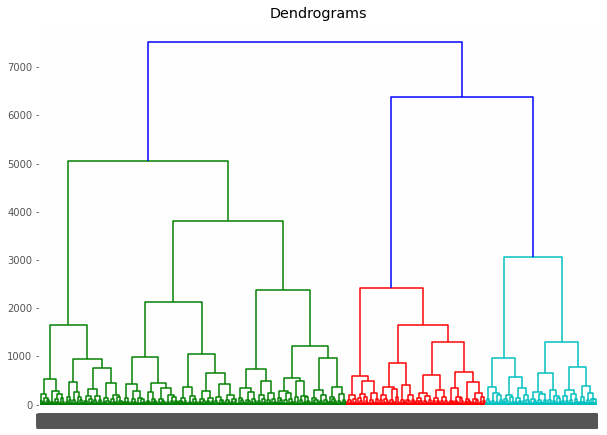

In [190]:
dendrogram_genetator(vec_df)

In [191]:
def dendrogram_genetator_with_thresold(df,thresold):
    plt.figure(figsize=(10, 7))
#     y=800
    plt.title("Dendrograms")  
    dend = shc.dendrogram(shc.linkage(df, method='ward'))
    plt.axhline(thresold, color='r', linestyle='--')
    

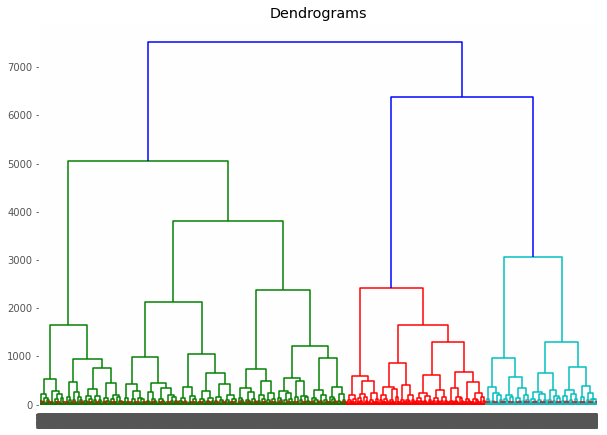

In [192]:
dendrogram_genetator_with_thresold(vec_df,40000)

In [193]:
def hierarchial_clustering(df):
    cluster = AgglomerativeClustering(n_clusters=4, affinity='euclidean', linkage='ward')  
    cluster.fit_predict(df)
    
    plt.figure(figsize=(10, 7))  
    plt.scatter(df['ft1'], df['ft2'], c=cluster.labels_) 
    

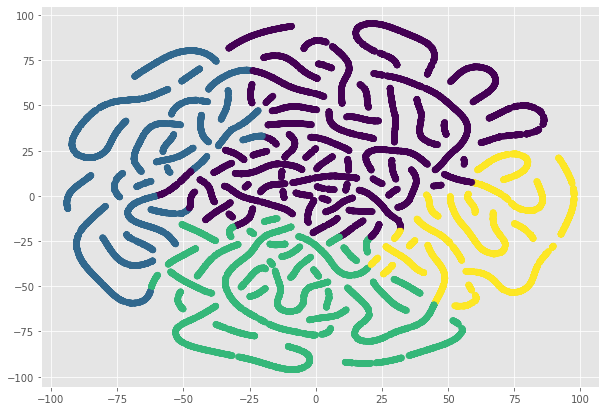

In [194]:
hierarchial_clustering(vec_df)

In [195]:
vec_df.set_index(cosine_df["cosine_similarity"], inplace = True) 
vec_df

,ft1,ft2
cosine_similarity,,
0.146531,-21.313841,89.893448
0.287763,83.958687,36.330658
0.142557,-74.797348,36.262020
0.180155,12.006520,-92.157234
0.222998,9.855525,-3.734700
...,...,...
0.169922,-5.843321,39.984093
0.137534,-88.494011,39.547516
0.149340,46.936321,-38.112896


In [196]:
def cluster_element_extraction(vec_df):
    sns.set_palette('Set1', 10, 0.65)
    palette = (sns.color_palette())
    #set_link_color_palette(map(rgb2hex, palette))
    sns.set_style('white')
    
    np.random.seed(25)
    
    link = linkage(vec_df, metric='correlation', method='ward')

    figsize(8, 3)
    den = dendrogram(link, labels=vec_df.index)
    plt.xticks(rotation=90)
    no_spine = {'left': True, 'bottom': True, 'right': True, 'top': True}
    sns.despine(**no_spine);

    plt.tight_layout()
    plt.savefig('feb2.png');
    
    cluster_idxs = defaultdict(list)
    for c, pi in zip(den['color_list'], den['icoord']):
        for leg in pi[1:3]:
            i = (leg - 5.0) / 10.0
            if abs(i - int(i)) < 1e-5:
                cluster_idxs[c].append(int(i))
                
    class Clusters(dict):
        def _repr_html_(self):
            html = '<table style="border: 0;">'
            for c in self:
                hx = rgb2hex(colorConverter.to_rgb(c))
                html += '<tr style="border: 0;">' \
                '<td style="background-color: {0}; ' \
                           'border: 0;">' \
                '<code style="background-color: {0};">'.format(hx)
                html += c + '</code></td>'
                html += '<td style="border: 0"><code>' 
                html += repr(self[c]) + '</code>'
                html += '</td></tr>'

            html += '</table>'

            return html
    
    cluster_classes = Clusters()
    for c, l in cluster_idxs.items():
        i_l = [den['ivl'][i] for i in l]
        cluster_classes[c] = i_l
        
    return cluster_classes
    

g
r


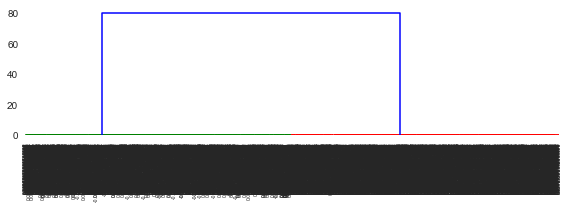

In [197]:
cluster_element_extraction(vec_df)

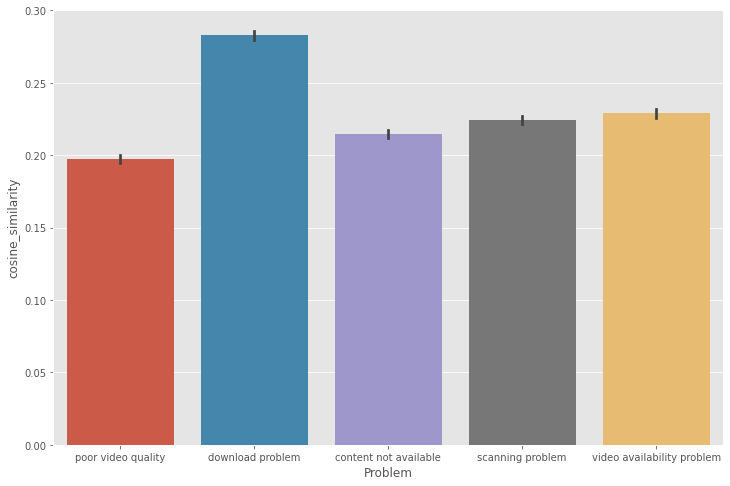

In [160]:
import matplotlib.pyplot as plt
import seaborn as sns
fig_dims = (12,8)
fig, ax = plt.subplots(figsize=fig_dims)
sns.barplot(x = 'Problem', y = 'cosine_similarity', ax=ax, data=review_prob_score_df)

In [153]:
review_prob_score_df.to_csv ('/Users/tanyachauhan/Documents/review_problem_score.csv', index = False, header=True)


In [180]:
    return frame

In [ ]:
vectorized_cosine_similarity_frame.index=cosine_list 

In [38]:
a_reset_df

,level_0,index,0,1,2,3,4,5,6,7,...,502,503,504,505,506,507,508,509,510,511
0,0,0,0.054941,-0.003439,0.002779,0.078137,0.003661,-0.036477,-0.029678,0.096106,...,-0.008415,-0.052776,-0.057675,-0.005002,-0.025055,0.070252,-0.026941,-0.065965,0.024125,-0.027194
1,1,0,0.036763,-0.034779,0.022192,0.044057,0.000747,0.045358,0.089506,0.015394,...,0.012991,0.001333,-0.055092,-0.055369,-0.009039,0.014461,-0.061095,0.010883,-0.015933,0.044640
2,2,0,0.009473,-0.059456,-0.042189,0.060656,-0.067813,0.033797,-0.002641,0.011808,...,-0.005049,0.024843,-0.065299,-0.057686,-0.066881,0.047134,0.005849,-0.035909,-0.073967,0.007783
3,3,0,0.066967,0.072401,0.024995,0.028659,-0.082440,-0.013143,0.017747,0.046939,...,0.011797,-0.019766,-0.036027,-0.066056,-0.017531,0.020583,0.000775,0.031952,0.013768,-0.057783
4,4,0,0.024528,0.017158,0.017532,0.039413,0.019387,0.002880,0.051680,0.084239,...,-0.021380,0.019050,-0.039439,-0.031765,-0.000461,0.000677,-0.065373,-0.017766,-0.042664,0.034182


In [1]:
# final_a_frame=a_reset_df.drop(['level_0', 'index'], axis=1)
# final_a_frame

In [2]:
# listOfADFRows = final_a_frame.to_numpy().tolist()
# listOfADFRows

In [3]:
# listOfRDFRows= final_review_frame.to_numpy().tolist()
# listOfRDFRows

In [57]:
# cosine_similarity(review_reset_df[0],a_reset_df[0])

In [98]:
print(l1)

[0.14653113087416392, 0.12827191362070167, 0.262385105267934, 0.1171287744394477, 0.2206952436091506, 0.1626958955764493, 0.15528512692667595, 0.17599336825894346, 0.16227520789434563, 0.12666055398760845, 0.10571054436083216, 0.14611099006767958, 0.46120248035942324, 0.1467181638733289, 0.06802246376580674, 0.2277277442582753, 0.11538864911789509, 0.2261279631294279, 0.17518285408120768, 0.24656969575172188, 0.18241861558468822, 0.054162487602955195, 0.1700826571907777, 0.04884340046265711, 0.13835320683428382, 0.2518620733363567, 0.29517175595025, 0.1456245887394144, 0.06969542739202286, 0.40509855743191964, 0.13865114655664856, 0.14314695827209223, 0.21309789083389308, 0.09992480749036468, 0.4603929963598694, 0.17131613729354325, 0.15067519429338483, 0.09517516202069992, 0.17092094507156802, 0.24766560486169628, 0.3924449612787422, 0.10455175652802629, 0.2116264433923214, 0.19653415568061489, 0.27343980572485976, 0.23617689566666034, 0.18380916811848325, 0.13044084068007475, 0.15281

In [91]:
listOfADFRows[0]

[0.05494138225913048,
 -0.0034387886989861727,
 0.002778756432235241,
 0.07813718169927597,
 0.003660845337435603,
 -0.036476586014032364,
 -0.029678361490368843,
 0.09610645473003387,
 -0.03457971289753914,
 0.002663443796336651,
 -0.07661142945289612,
 0.07278282195329666,
 0.03820878639817238,
 -0.008021386340260506,
 0.0728655457496643,
 0.0540521964430809,
 -0.037857379764318466,
 -0.01883510872721672,
 0.051956482231616974,
 0.035554755479097366,
 -0.02514117769896984,
 -0.012931051664054394,
 0.016876349225640297,
 0.09120917320251465,
 0.013770468533039093,
 -0.03614739328622818,
 0.013964297249913216,
 -0.05383498594164848,
 0.009385084733366966,
 -0.05077899992465973,
 0.0311942957341671,
 0.0012478340649977326,
 -0.05472873896360397,
 -0.020042259246110916,
 -0.06407879292964935,
 -0.018533989787101746,
 0.030888834968209267,
 0.09159410744905472,
 0.055695101618766785,
 -0.007830865681171417,
 -0.03240160644054413,
 -0.006978130433708429,
 -0.04875783994793892,
 0.013256106

In [94]:
k=cosine_similarity([listOfADFRows[0]],[listOfRDFRows[0]])
k

array([[0.14653113]])

In [96]:
k[0][0]

0.14653113087416392

In [623]:
a=['poor video quality','download problem','content not available','scanning problem','video availability problem']
for i in range(len(a)):
    a[i]=a[i].lower()
print(a)
type(a)

['poor video quality', 'download problem', 'content not available', 'scanning problem', 'video availability problem']


list

In [619]:
list_of_list=[processed_review_text,a]
list_of_list

[['best app students ',
  'app usefull students teachers ',
  'work mobile even android ',
  'good app secondary school teacher notice dixa smart work would like little contribute ',
  'good app lean ',
  'use book marathi gujarat l english language please ',
  'informative app load learn materials specially teachers want enhance knowledge ',
  'app great help learn mathsit extraordinary ',
  'app useful students ',
  'app helpful students teachers ',
  'useful learn every one ',
  'good aap understand much ',
  'cant able see video scan qr code many time video display ',
  'excellent app teachers students ',
  'try child st standard ssc board content fully available poetry songs app text book different interactive level require effective ',
  'studentcontent come sad ',
  'helfull teacher students ',
  'hi sir use old versions android mobile support please update ',
  'imp useful app ',
  'know reason content standard need ',
  'good interest helpful app free help teach lesson ',
  't

In [17]:
# new_df.insert(2,'Star Rating',eng_df['Star Rating'])

In [19]:
# def unlisting_list_of_list(list_of_list):
#     merged = list(itertools.chain(*list_of_list))
#     kywrd_ls= list(set(merged))
#     return(kywrd_ls)

def unlisting_list_of_list(list_of_list):
    merged = list(itertools.chain(*list_of_list))
    review_ls= list(set(merged))
    return(review_ls)


In [20]:
# kywrd_df_ls = list(new_df["Keywords"])
# kywrd_df_ls

In [21]:
# merged = list(itertools.chain(*kywrd_df_ls))
# kywrd_ls= list(set(merged))
# kywrd_ls
# kywrd_ls=unlisting_list_of_list(kywrd_df_ls)
# print(kywrd_ls)

In [22]:
review_df_ls = list(new_df["Review Text"])
review_df_ls

['good but not much',
 'Good application',
 'Nice explanation',
 'Best app 4 students',
 'ok',
 'Excellent',
 'Ok',
 'This app very usefull for students and teachers',
 'Good',
 'Wow amazing',
 'Not working on mobile even its android 7.3',
 'Very very bad app👿👿😡😡😠😠😤😤',
 'Easy to learn',
 'Excellent',
 'Very good app. I am a secondary school teacher, & I notice dixa doing smart work.... I would like to do my little contribute...',
 'It is very useful',
 'This is very importent for studes',
 'Excellent',
 'Unique',
 'It is a good app for leaning',
 'It is very helpful to us',
 'Super teaching',
 'How to use it all book are in marathi or Gujarat l had all in English language Please',
 '👌👌',
 'good application',
 'Informative app with loads of learning materials specially for teachers who wants to enhance their knowledge.',
 'Very good app',
 'This app is a great help to learn maths.It is extraordinary.',
 'The app is very useful to you and all students',
 'This app very helpful for studen

In [135]:
def sentiment_score_count(review_df_ls):
    sentiment_class = []
    pos_score = []
    neu_score = []
    neg_score = []
    for i in review_df_ls:
        sid_obj = SentimentIntensityAnalyzer()  
        sentiment_dict = sid_obj.polarity_scores(i)  
        #print("Overall sentiment dictionary is : ", sentiment_dict) 
        neg_score.append(sentiment_dict['pos']) 
        neu_score.append(sentiment_dict['neg']) 
        pos_score.append(sentiment_dict['neu'])
        if sentiment_dict['compound'] >= 0.05 : 
            sentiment_class.append("Positive") 

        elif sentiment_dict['compound'] <= -0.05 : 
            sentiment_class.append("Negative") 

        else : 
            sentiment_class.append("Neutral")
            
    sentiment_df = pd.DataFrame(list(zip(neg_score, neu_score, pos_score, sentiment_class )), 
               columns =['pos_score','neg_score','neu_score','sentiment_class']) 
    return sentiment_df 

In [136]:
sentiment_df = sentiment_score_count(review_df_ls)
sentiment_df

,pos_score,neg_score,neu_score,sentiment_class
0,0.394,0.00,0.606,Positive
1,0.744,0.00,0.256,Positive
2,0.737,0.00,0.263,Positive
3,0.583,0.00,0.417,Positive
4,1.000,0.00,0.000,Positive
...,...,...,...,...
11849,0.000,0.00,1.000,Neutral
11850,0.169,0.15,0.681,Negative
11851,0.677,0.00,0.323,Positive
11852,0.737,0.00,0.263,Positive


In [137]:
# joining two dataframes
joined_df = new_df.join(sentiment_df) 
joined_df

,Review Text,Keywords,pos_score,neg_score,neu_score,sentiment_class
0,good but not much,"[much, good]",0.394,0.00,0.606,Positive
1,Good application,[good application],0.744,0.00,0.256,Positive
2,Nice explanation,[nice explanation],0.737,0.00,0.263,Positive
3,Best app 4 students,"[app, students]",0.583,0.00,0.417,Positive
4,ok,[ok],1.000,0.00,0.000,Positive
...,...,...,...,...,...,...
11849,Sadanand Kushwaha,[sadanand kushwaha],0.000,0.00,1.000,Neutral
11850,I am a student . It is very good app but its p...,"[, good app, picture, dull, student, sound qua...",0.169,0.15,0.681,Negative
11851,Well app,[],0.677,0.00,0.323,Positive
11852,Nice video,[nice video],0.737,0.00,0.263,Positive


In [138]:
eng_df.sort_values("Review Submit Date and Time", axis = 0, ascending = True, 
                 inplace = True, na_position ='first') 
  
eng_df
list_of_date = eng_df['Review Submit Date and Time'].to_list()
# print(list_of_date)
list_year_month=[]
for i in list_of_date:
    list_year_month.append(i[:7])
print(list_year_month)
    

['2018-07', '2018-09', '2018-12', '2018-12', '2019-03', '2019-05', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-06', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07', '2019-07'

In [139]:
# selected_col = eng_df[['Review Submit Date and Time']].copy()
# selected_col
selected_col=pd.DataFrame(list_year_month,columns = ["Review Submit Date and Time"]) 
selected_col



,Review Submit Date and Time
0,2018-07
1,2018-09
2,2018-12
3,2018-12
4,2019-03
...,...
11849,2020-03
11850,2020-03
11851,2020-03
11852,2020-03


In [140]:
final_df = joined_df.join(selected_col) 
final_df

,Review Text,Keywords,pos_score,neg_score,neu_score,sentiment_class,Review Submit Date and Time
0,good but not much,"[much, good]",0.394,0.00,0.606,Positive,2018-07
1,Good application,[good application],0.744,0.00,0.256,Positive,2018-09
2,Nice explanation,[nice explanation],0.737,0.00,0.263,Positive,2018-12
3,Best app 4 students,"[app, students]",0.583,0.00,0.417,Positive,2018-12
4,ok,[ok],1.000,0.00,0.000,Positive,2019-03
...,...,...,...,...,...,...,...
11849,Sadanand Kushwaha,[sadanand kushwaha],0.000,0.00,1.000,Neutral,2020-03
11850,I am a student . It is very good app but its p...,"[, good app, picture, dull, student, sound qua...",0.169,0.15,0.681,Negative,2020-03
11851,Well app,[],0.677,0.00,0.323,Positive,2020-03
11852,Nice video,[nice video],0.737,0.00,0.263,Positive,2020-03


In [141]:
def polarity_and_subjectivity(review_df_ls):
    # List of sentiments of each review text
    sentiments = []

    for i in review_df_ls:
        blob = TextBlob(i)
        s = blob.sentiment
        sentiments.append(s)
    
    # Creating a dataframe of sentiments
    sentiment = pd.DataFrame(sentiments)
    return sentiment

In [142]:
sentiment = polarity_and_subjectivity(review_df_ls)
sentiment

,polarity,subjectivity
0,0.300000,0.400000
1,0.700000,0.600000
2,0.600000,1.000000
3,1.000000,0.300000
4,0.500000,0.500000
...,...,...
11849,0.000000,0.000000
11850,0.503333,0.493333
11851,0.000000,0.000000
11852,0.600000,1.000000


In [143]:
final_df2 = final_df.join(sentiment) 
final_df2[51:100]

,Review Text,Keywords,pos_score,neg_score,neu_score,sentiment_class,Review Submit Date and Time,polarity,subjectivity
51,Bad,[bad],0.000,1.000,0.000,Negative,2019-07,-0.700000,0.666667
52,this app is be beautiful,"[app, beautiful]",0.494,0.000,0.506,Positive,2019-07,0.850000,1.000000
53,It so easy to learn,[easy],0.444,0.000,0.556,Positive,2019-07,0.433333,0.833333
54,Man,[man],0.000,0.000,1.000,Neutral,2019-07,0.000000,0.000000
55,Can I know the reason why there is no content ...,"[reason, , content, standard]",0.000,0.115,0.885,Negative,2019-07,0.250000,0.250000
56,"Excellent ,super,good","[good, excellent, super]",0.787,0.000,0.213,Positive,2019-07,1.000000,1.000000
57,it is very good interesting and helpful app . ...,"[helpful app, good interesting, lesson, free]",0.555,0.000,0.445,Positive,2019-07,0.603333,0.693333
58,Very useful app,[useful app],0.615,0.000,0.385,Positive,2019-07,0.390000,0.000000
59,Truly helpful. Better if 21st century skills a...,"[, students, teachers, helpful, great help, 21...",0.556,0.000,0.444,Positive,2019-07,0.433333,0.416667
60,👌👌👌👌👌,[],1.000,0.000,0.000,Positive,2019-07,0.000000,0.000000


In [144]:
final_df2.drop(["Keywords"],axis = 1,inplace = True) 
  
# display 
final_df2 

,Review Text,pos_score,neg_score,neu_score,sentiment_class,Review Submit Date and Time,polarity,subjectivity
0,good but not much,0.394,0.00,0.606,Positive,2018-07,0.300000,0.400000
1,Good application,0.744,0.00,0.256,Positive,2018-09,0.700000,0.600000
2,Nice explanation,0.737,0.00,0.263,Positive,2018-12,0.600000,1.000000
3,Best app 4 students,0.583,0.00,0.417,Positive,2018-12,1.000000,0.300000
4,ok,1.000,0.00,0.000,Positive,2019-03,0.500000,0.500000
...,...,...,...,...,...,...,...,...
11849,Sadanand Kushwaha,0.000,0.00,1.000,Neutral,2020-03,0.000000,0.000000
11850,I am a student . It is very good app but its p...,0.169,0.15,0.681,Negative,2020-03,0.503333,0.493333
11851,Well app,0.677,0.00,0.323,Positive,2020-03,0.000000,0.000000
11852,Nice video,0.737,0.00,0.263,Positive,2020-03,0.600000,1.000000


In [346]:
pos = final_df2.loc[final_df2['sentiment_class']=='Positive']
pos_df = pd.DataFrame(pos)
pos_df[0:50]


,Review Text,pos_score,neg_score,neu_score,sentiment_class,Review Submit Date and Time,polarity,subjectivity,lower_desc
0,good but not much,0.394,0.0,0.606,Positive,2018-07,0.300000,0.400000,<map object at 0x1406c4d60>
1,Good application,0.744,0.0,0.256,Positive,2018-09,0.700000,0.600000,<map object at 0x1406c4d60>
2,Nice explanation,0.737,0.0,0.263,Positive,2018-12,0.600000,1.000000,<map object at 0x1406c4d60>
3,Best app 4 students,0.583,0.0,0.417,Positive,2018-12,1.000000,0.300000,<map object at 0x1406c4d60>
4,ok,1.000,0.0,0.000,Positive,2019-03,0.500000,0.500000,<map object at 0x1406c4d60>
5,Excellent,1.000,0.0,0.000,Positive,2019-05,1.000000,1.000000,<map object at 0x1406c4d60>
6,Ok,1.000,0.0,0.000,Positive,2019-06,0.500000,0.500000,<map object at 0x1406c4d60>
8,Good,1.000,0.0,0.000,Positive,2019-06,0.700000,0.600000,<map object at 0x1406c4d60>
9,Wow amazing,1.000,0.0,0.000,Positive,2019-06,0.350000,0.950000,<map object at 0x1406c4d60>
12,Easy to learn,0.592,0.0,0.408,Positive,2019-06,0.433333,0.833333,<map object at 0x1406c4d60>


In [351]:
from nltk.corpus import stopwords
stopwords = stopwords.words('english')
import re

def leaves(tree):
    """Finds NP (nounphrase) leaf nodes of a chunk tree."""
    for subtree in tree.subtrees(filter = lambda t: t.label()=='NP'):
       # The yield statement suspends function’s execution and sends a value back to the caller.
        yield subtree.leaves()

def acceptable_word(word):
    """Checks conditions for acceptable word: length, stopword."""
    accepted = bool(2 <= len(word) <= 40
                    and word.lower() not in stopwords)
    return accepted

def get_terms(tree):

    for leaf in leaves(tree):
        term = [ w for w,t in leaf if acceptable_word(w) ]
        yield term


In [352]:
grammar =r"""
  NP: {<DT|JJ|NN.*>+}          
  PP: {<IN><NP>}            
  VP: {<VB.*><NP|PP|CLAUSE>+$}
  CLAUSE: {<NP><VP>}          
  """
      
    

In [353]:
def phrase_extraction(text, grammar):
    text = text.lower()
    sentence_re = r'''(?x)          
      (?:[A-Z]\.)+        
    | \w+(?:-\w+)*        
    | \$?\d+(?:\.\d+)?%?  
    | \.\.\.              
    | [][.,;"'?():_`-]    
    '''
    
    ls = [] 
    word_token_ls = text.split(" ")

    toks = nltk.regexp_tokenize(text, sentence_re)
    postoks = nltk.tag.pos_tag(toks)
    
    chunker = nltk.RegexpParser(grammar)
    
    tree = chunker.parse(postoks)
    terms = get_terms(tree)
    for term in terms:
        ls.append(" ".join(term)) 
    return list(set(ls))



In [354]:
list_pos_review= list(pos_df["Review Text"])
print(list_pos_review)

['This app very usefull for students and teachers', 'Not working on mobile even its android 7.3', 'This is very importent for studes', 'Unique', 'Informative app with loads of learning materials specially for teachers who wants to enhance their knowledge.', 'It is very use full', "I can't able to see the video I scanned the QR code many times but the video is not displaying", 'Helfull teacher &students', 'y8i', 'Man', 'शिक्षकांचा मित्र', 'बहुत अच्छा विषय प्रस्तुत की जा रही हैं।', 'Disc H DVD', 'I can use this app any where without use of any books', 'Very excelent', 'खूप सुंदर! शिक्षक,पालक व विद्यार्थ्यांसाठी अतिशय उपयुक्त आहे.', '👍👍', 'Usefull to d.s.c exams', 'Add to all subject', "QR CODE ISN'T WORKING CORRECTLY .....SAID TO ME ,'' YOUR STATE WILL SOON ADD CONTENT FOR THIS QR CODE. IT WILL BE AVAILABLE SHORTLY.'' Why??", 'Didi', '👍👍good app', 'Wast app not coming properly', 'Gd', 'DIKSHA _ National', 'It was usefull for children .', 'Cycle Diksha', 'Arun Kashyap And Vk', 'All in one

In [504]:
def vectorization_of_list(positive_review):
    #word embedding(vectorization)
    embed = hub.Module("/Users/tanyachauhan/Downloads/3")
    tf.logging.set_verbosity(tf.logging.ERROR)
    with tf.Session() as session:
        session.run([tf.global_variables_initializer(), tf.tables_initializer()])
        message_embeddings = session.run(embed(positive_review))
#         print(message_embeddings)
        lst = []
        for i in message_embeddings:
            df = pd.DataFrame([i])
            lst.append(df)
    frame = pd.concat(lst)
    return frame

In [505]:
frame = vectorization_of_list(list_pos_review)
frame

,0,1,2,3,4,5,6,7,8,9,...,502,503,504,505,506,507,508,509,510,511
0,-0.039647,-0.034502,0.037866,0.002802,-0.049400,0.014556,0.008097,0.025805,-0.031768,0.030853,...,-0.075235,-0.033080,-0.002340,-0.064227,-0.028994,-0.056506,0.002067,-0.069043,0.031434,0.020080
0,-0.007273,-0.043129,0.009774,0.051854,0.001489,-0.045962,0.065839,-0.011821,-0.056093,0.033481,...,-0.045960,-0.055602,-0.068057,0.030808,-0.028282,0.074422,-0.056662,-0.048395,-0.009641,0.008047
0,0.009136,-0.005452,0.015851,0.010692,-0.007655,-0.015547,-0.058051,-0.005819,-0.157762,0.026107,...,0.002869,0.013775,0.035747,0.019353,0.021026,-0.003556,0.028844,-0.029353,-0.035293,0.010684
0,-0.039222,0.026314,0.006534,-0.031962,0.008025,0.021257,-0.014376,-0.013392,-0.108106,-0.040354,...,0.040373,0.039355,-0.010712,-0.047701,-0.047185,-0.054769,0.028746,0.051617,0.046004,-0.046629
0,0.013733,-0.003359,0.060463,-0.009357,-0.067909,0.001103,0.006764,0.030561,-0.025238,0.027455,...,-0.094484,-0.053543,-0.015520,-0.028662,0.027847,-0.027235,0.039441,-0.089243,0.028683,0.004682
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,0.051289,-0.016381,-0.038509,0.048535,-0.087648,0.024630,0.017214,0.044077,-0.039763,0.045355,...,-0.115595,-0.036264,-0.052633,-0.033768,0.014574,-0.018994,0.013179,-0.080152,-0.030884,-0.017111
0,0.047237,0.005415,-0.059860,0.008748,-0.096850,0.063281,-0.025240,-0.010711,-0.070031,0.042835,...,0.042663,0.055956,0.008997,-0.044156,0.059843,-0.002178,-0.096301,0.015588,-0.035132,-0.018911
0,0.021482,-0.011756,0.043744,0.039255,-0.073132,0.032760,0.034751,0.014633,-0.088503,0.002183,...,-0.037047,-0.043458,0.079279,-0.080260,0.022058,-0.049706,0.009871,0.035240,-0.018331,0.023048
0,0.042919,-0.026954,-0.029317,-0.064036,-0.050566,0.062739,-0.004476,-0.030918,-0.097470,0.022744,...,-0.021682,0.074790,0.021177,-0.081378,-0.011701,-0.000881,-0.057674,0.071015,-0.046408,0.040916


In [356]:
new_pos_df = pd.DataFrame(columns=['Review Text', 'Keywords'])

for i in list_pos_review:
    if(i == ''):
        new_pos_df = new_pos_df.append({'Review Text': i, 'Keywords': '[]'}, ignore_index=True)
    else:
        x = phrase_extraction(i, grammar)
        new_pos_df = new_pos_df.append({'Review Text': i, 'Keywords': x}, ignore_index=True)

new_pos_df[0:50]
    

,Review Text,Keywords
0,This app very usefull for students and teachers,"[app, students, teachers, usefull]"
1,Not working on mobile even its android 7.3,"[android, mobile]"
2,This is very importent for studes,"[, studes, importent]"
3,Unique,[unique]
4,Informative app with loads of learning materia...,"[informative app, loads, knowledge, teachers, ..."
5,It is very use full,[use full]
6,I can't able to see the video I scanned the QR...,"[, video, able, qr code many times]"
7,Helfull teacher &students,[helfull teacher students]
8,y8i,[y8i]
9,Man,[man]


In [415]:
pos_l=list(new_pos_df["Keywords"])
pos_l


[['app', 'students', 'teachers', 'usefull'],
 ['android', 'mobile'],
 ['', 'studes', 'importent'],
 ['unique'],
 ['informative app', 'loads', 'knowledge', 'teachers', 'materials'],
 ['use full'],
 ['', 'video', 'able', 'qr code many times'],
 ['helfull teacher students'],
 ['y8i'],
 ['man'],
 ['षक'],
 ['बह अच षय रस रह'],
 ['disc dvd'],
 ['', 'app', 'use', 'books'],
 ['excelent'],
 ['लक अत शय उपय आह', 'दर षक'],
 [],
 ['', 'exams', 'usefull'],
 ['subject'],
 ['', 'available', 'qr code', 'content', 'state'],
 ['didi'],
 ['good app'],
 ['wast'],
 ['gd'],
 ['national', 'diksha'],
 ['children', 'usefull'],
 ['cycle diksha'],
 ['arun kashyap', 'vk'],
 [''],
 [],
 ['vool'],
 [],
 [],
 ['kkkk'],
 [],
 ['narayna'],
 ['ஒர ணவன எனக பயன ளத இர'],
 ['class'],
 ['subject'],
 ['പർ'],
 ['bihola anchal'],
 ['install'],
 ['pd'],
 ['षण बह उपय नक', 'इसस हम अध पक नय षय पढ़ बह गमत'],
 ['बच सह यक'],
 ['exellent बह अच'],
 ['third class'],
 ['book covers', 'classes'],
 ['topices', 'maximum videos'],
 ['exallent'],

In [417]:
list_pos_df=pd.DataFrame(pos_l)
pos_count=list_pos_df[0].value_counts()
pos_count[0:50]

                245
app             102
supper           37
use full         17
diksha           16
usefull app      15
supper app       12
students         11
full             11
video            10
student          10
usefull           9
diksha app        9
videos            9
mast              9
books             8
teachers          8
need              7
excelent          7
full app          7
study             7
class             7
osm               6
open              6
பர                6
nyc               6
content           6
exlent            5
supar             5
use               5
gud               5
nise              5
knowledge         5
work              4
use ful           4
நன                4
contents          4
helpfull          4
teacher           4
dlksha            4
spr               4
oooo              3
karthik           3
learning          3
children          3
wast              3
average           3
new syllabus      3
बह दर             3
yash              3


In [459]:
import re
my_pos_list=list_pos_df[0].tolist()
my_pos_list
new_pos_list = [y.lower() for y in list_pos_review if re.search('exlent', y)]
new_pos_list


['exlent']

In [374]:
neg = final_df2.loc[final_df2['sentiment_class']=='Negative']
neg_df = pd.DataFrame(neg)
neg_df[0:50]



,Review Text,pos_score,neg_score,neu_score,sentiment_class,Review Submit Date and Time,polarity,subjectivity,lower_desc
11,Very very bad app👿👿😡😡😠😠😤😤,0.000,0.412,0.588,Negative,2019-06,-0.910000,0.866667,<map object at 0x1406c4d60>
31,Its a good aap but not understand as much as ....,0.103,0.156,0.741,Negative,2019-06,0.450000,0.400000,<map object at 0x1406c4d60>
36,my studentcontent is not coming I am so sad,0.000,0.333,0.667,Negative,2019-06,-0.500000,1.000000,<map object at 0x1406c4d60>
42,Hi sir I am using old versions android mobile ...,0.000,0.260,0.740,Negative,2019-06,0.100000,0.200000,<map object at 0x1406c4d60>
51,Bad,0.000,1.000,0.000,Negative,2019-07,-0.700000,0.666667,<map object at 0x1406c4d60>
55,Can I know the reason why there is no content ...,0.000,0.115,0.885,Negative,2019-07,0.250000,0.250000,<map object at 0x1406c4d60>
84,😠😠😠😠😠,0.000,0.767,0.233,Negative,2019-07,0.000000,0.000000,<map object at 0x1406c4d60>
103,I give this app only one star as it is not hel...,0.061,0.164,0.775,Negative,2019-07,-0.333333,0.700000,<map object at 0x1406c4d60>
166,Useless they don't have video's what we want e...,0.107,0.231,0.661,Negative,2019-07,-0.500000,0.200000,<map object at 0x1406c4d60>
168,Bad,0.000,1.000,0.000,Negative,2019-07,-0.700000,0.666667,<map object at 0x1406c4d60>


In [375]:
from nltk.corpus import stopwords
stopwords = stopwords.words('english')
import re

def leaves(tree):
    """Finds NP (nounphrase) leaf nodes of a chunk tree."""
    for subtree in tree.subtrees(filter = lambda t: t.label()=='NP'):
       # The yield statement suspends function’s execution and sends a value back to the caller.
        yield subtree.leaves()

def acceptable_word(word):
    """Checks conditions for acceptable word: length, stopword."""
    accepted = bool(2 <= len(word) <= 40
                    and word.lower() not in stopwords)
    return accepted

def get_terms(tree):

    for leaf in leaves(tree):
        term = [ w for w,t in leaf if acceptable_word(w) ]
        yield term


In [376]:
grammar =r"""
  NP: {<DT|JJ|NN.*>+}          
  PP: {<IN><NP>}            
  VP: {<VB.*><NP|PP|CLAUSE>+$}
  CLAUSE: {<NP><VP>}          
  """
      
    

In [377]:
def phrase_extraction(text, grammar):
    text = text.lower()
    sentence_re = r'''(?x)          
      (?:[A-Z]\.)+        
    | \w+(?:-\w+)*        
    | \$?\d+(?:\.\d+)?%?  
    | \.\.\.              
    | [][.,;"'?():_`-]    
    '''
    
    ls = [] 
    word_token_ls = text.split(" ")

    toks = nltk.regexp_tokenize(text, sentence_re)
    postoks = nltk.tag.pos_tag(toks)
    
    chunker = nltk.RegexpParser(grammar)
    
    tree = chunker.parse(postoks)
    terms = get_terms(tree)
    for term in terms:
        ls.append(" ".join(term)) 
    return list(set(ls))



In [378]:
list_neg_review= list(neg_df["Review Text"])
print(list_neg_review)

['Very very bad app👿👿😡😡😠😠😤😤', 'Its a good aap but not understand as much as ...........😕😒👽', 'my studentcontent is not coming I am so sad', 'Hi sir I am using old versions android mobile this not support please update', 'Bad', 'Can I know the reason why there is no content for standard 12? They need it the most.', '😠😠😠😠😠', "I give this app only one star as it is not helpful for me . It is not working properly , i didn't get some answers from this app DIKSHA but i don't want tell that it is worst app . Thank you DIKSHA .", "Useless they don't have video's what we want every time", 'Bad', 'Worst app, very slow loading.', 'Very worst app', "These is so borring i am tired now please who also don't download 🙄😔☹️", 'This is a very irritating app', 'I have not received any otp and it is saying otp is resent, what is wrong with it', 'This app is very bad and useless..', 'No use 🤬🤬😠', 'Good but they is no 2m,3m,5m', 'Hi Miss', 'Worst app', 'I wanted to see maths 2 chp no. 5 They just gave an in

In [491]:
def vectorization_of_list(negative_review):
    #word embedding(vectorization)
    embed = hub.Module("/Users/tanyachauhan/Downloads/3")
    tf.logging.set_verbosity(tf.logging.ERROR)
    with tf.Session() as session:
        session.run([tf.global_variables_initializer(), tf.tables_initializer()])
        message_embeddings = session.run(embed(negative_review))
#         print(message_embeddings)
        lst = []
        for i in message_embeddings:
            df = pd.DataFrame([i])
            lst.append(df)
    frame = pd.concat(lst)
    return frame

In [492]:
frame = vectorization_of_list(list_neg_review)
frame

,0,1,2,3,4,5,6,7,8,9,...,502,503,504,505,506,507,508,509,510,511
0,0.046801,-0.013688,0.027126,-0.000042,-0.026524,-0.008972,-0.005673,-0.048381,-0.144524,0.022072,...,-0.025478,-0.040405,0.023924,0.029969,0.006550,-0.035842,0.039035,0.006601,-0.048776,-0.018567
0,0.072809,0.068226,-0.036361,0.051545,-0.100178,-0.065455,-0.060814,0.027177,-0.051470,0.032919,...,-0.086864,0.030254,0.069845,0.000461,0.041815,-0.005815,0.055943,-0.045273,0.034072,0.057801
0,0.024775,-0.058140,-0.047132,0.057511,-0.051774,0.037290,0.051977,0.003986,-0.084373,0.033459,...,-0.028021,-0.015143,-0.031802,0.027606,0.010684,0.023537,-0.028195,0.004472,-0.013016,-0.028352
0,0.008794,-0.069257,0.035579,-0.013228,0.007653,-0.026667,0.069616,-0.005432,-0.040354,0.038486,...,-0.052191,-0.081706,-0.033232,0.020724,0.040868,0.063534,-0.076634,-0.056778,-0.006015,0.069136
0,0.053620,-0.020659,0.027664,0.045728,-0.028162,-0.028565,0.021897,-0.022609,-0.111288,0.048189,...,-0.056925,-0.036435,-0.008220,0.039682,-0.025030,-0.071660,0.008647,0.018417,0.022292,-0.039992
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,0.051820,0.019749,0.059953,0.108363,-0.012559,-0.105472,-0.037863,0.079198,-0.058903,0.033039,...,-0.017623,-0.012118,-0.005760,0.003828,-0.007718,0.057417,-0.049079,-0.012937,0.022631,-0.082622
0,-0.013428,0.008036,0.033544,0.068620,0.011321,0.036953,0.065270,-0.008205,-0.057114,0.041381,...,-0.054102,-0.053597,-0.021910,0.022404,0.012692,0.014759,-0.065715,-0.055199,-0.037268,0.049064
0,0.058746,-0.020633,0.012207,0.047734,-0.026932,-0.040138,0.015585,-0.030391,-0.120316,0.047165,...,-0.048856,-0.059141,-0.007795,0.053639,-0.012652,-0.052691,0.014214,0.013994,0.024455,-0.038147
0,0.051648,-0.012064,0.006341,0.075037,-0.027697,0.024401,0.051596,-0.007179,-0.035889,0.056933,...,0.018888,-0.049385,-0.056976,0.039024,0.017571,0.033461,-0.048842,-0.051663,0.000307,0.027052


In [493]:
negative_review_text_df = pd.DataFrame(list_neg_review,columns=['Review Text'])
negative_review_text_df

,Review Text
0,Very very bad app👿👿😡😡😠😠😤😤
1,Its a good aap but not understand as much as ....
2,my studentcontent is not coming I am so sad
3,Hi sir I am using old versions android mobile ...
4,Bad
...,...
641,Very poor data n narration.
642,It is the worst app ever.the videos and conten...
643,Very bad
644,"I am not able to download in laptop, lots of s..."


In [495]:
frame.set_index(negative_review_text_df["Review Text"], inplace = True) 


In [496]:
frame

,0,1,2,3,4,5,6,7,8,9,...,502,503,504,505,506,507,508,509,510,511
Review Text,,,,,,,,,,,,,,,,,,,,,
Very very bad app👿👿😡😡😠😠😤😤,0.046801,-0.013688,0.027126,-0.000042,-0.026524,-0.008972,-0.005673,-0.048381,-0.144524,0.022072,...,-0.025478,-0.040405,0.023924,0.029969,0.006550,-0.035842,0.039035,0.006601,-0.048776,-0.018567
Its a good aap but not understand as much as ...........😕😒👽,0.072809,0.068226,-0.036361,0.051545,-0.100178,-0.065455,-0.060814,0.027177,-0.051470,0.032919,...,-0.086864,0.030254,0.069845,0.000461,0.041815,-0.005815,0.055943,-0.045273,0.034072,0.057801
my studentcontent is not coming I am so sad,0.024775,-0.058140,-0.047132,0.057511,-0.051774,0.037290,0.051977,0.003986,-0.084373,0.033459,...,-0.028021,-0.015143,-0.031802,0.027606,0.010684,0.023537,-0.028195,0.004472,-0.013016,-0.028352
Hi sir I am using old versions android mobile this not support please update,0.008794,-0.069257,0.035579,-0.013228,0.007653,-0.026667,0.069616,-0.005432,-0.040354,0.038486,...,-0.052191,-0.081706,-0.033232,0.020724,0.040868,0.063534,-0.076634,-0.056778,-0.006015,0.069136
Bad,0.053620,-0.020659,0.027664,0.045728,-0.028162,-0.028565,0.021897,-0.022609,-0.111288,0.048189,...,-0.056925,-0.036435,-0.008220,0.039682,-0.025030,-0.071660,0.008647,0.018417,0.022292,-0.039992
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Very poor data n narration.,0.051820,0.019749,0.059953,0.108363,-0.012559,-0.105472,-0.037863,0.079198,-0.058903,0.033039,...,-0.017623,-0.012118,-0.005760,0.003828,-0.007718,0.057417,-0.049079,-0.012937,0.022631,-0.082622
"It is the worst app ever.the videos and content is not available.the videos are not played says""UNAVAILABLE VIDEO AND CONTENT"".please do not download this app.not at all satisfied.😠😡🤬",-0.013428,0.008036,0.033544,0.068620,0.011321,0.036953,0.065270,-0.008205,-0.057114,0.041381,...,-0.054102,-0.053597,-0.021910,0.022404,0.012692,0.014759,-0.065715,-0.055199,-0.037268,0.049064
Very bad,0.058746,-0.020633,0.012207,0.047734,-0.026932,-0.040138,0.015585,-0.030391,-0.120316,0.047165,...,-0.048856,-0.059141,-0.007795,0.053639,-0.012652,-0.052691,0.014214,0.013994,0.024455,-0.038147


In [497]:
def TSNE_3D(df):
    %pylab inline 

    #Reduce Dimensinality
    X_embedded = TSNE(n_components=3).fit_transform(df)
    vec_df = pd.DataFrame(X_embedded, columns=["ft1","ft2","ft3"])
    #vec_df
    #plot 3-D graph
    fig = px.scatter_3d(vec_df,x="ft1",y="ft2",z="ft3")
    fig.show()

In [498]:
TSNE_3D(frame)

Populating the interactive namespace from numpy and matplotlib


/Users/tanyachauhan/myenv/lib/python3.8/site-packages/IPython/core/magics/pylab.py:159: UserWarning:

pylab import has clobbered these variables: ['random']
`%matplotlib` prevents importing * from pylab and numpy



In [499]:
def dendrogram_genetator(df):
    plt.figure(figsize=(10, 7))  
    plt.title("Dendrograms")  
    dend = shc.dendrogram(shc.linkage(df, method='ward'))
    

In [500]:
frame

,0,1,2,3,4,5,6,7,8,9,...,502,503,504,505,506,507,508,509,510,511
Review Text,,,,,,,,,,,,,,,,,,,,,
Very very bad app👿👿😡😡😠😠😤😤,0.046801,-0.013688,0.027126,-0.000042,-0.026524,-0.008972,-0.005673,-0.048381,-0.144524,0.022072,...,-0.025478,-0.040405,0.023924,0.029969,0.006550,-0.035842,0.039035,0.006601,-0.048776,-0.018567
Its a good aap but not understand as much as ...........😕😒👽,0.072809,0.068226,-0.036361,0.051545,-0.100178,-0.065455,-0.060814,0.027177,-0.051470,0.032919,...,-0.086864,0.030254,0.069845,0.000461,0.041815,-0.005815,0.055943,-0.045273,0.034072,0.057801
my studentcontent is not coming I am so sad,0.024775,-0.058140,-0.047132,0.057511,-0.051774,0.037290,0.051977,0.003986,-0.084373,0.033459,...,-0.028021,-0.015143,-0.031802,0.027606,0.010684,0.023537,-0.028195,0.004472,-0.013016,-0.028352
Hi sir I am using old versions android mobile this not support please update,0.008794,-0.069257,0.035579,-0.013228,0.007653,-0.026667,0.069616,-0.005432,-0.040354,0.038486,...,-0.052191,-0.081706,-0.033232,0.020724,0.040868,0.063534,-0.076634,-0.056778,-0.006015,0.069136
Bad,0.053620,-0.020659,0.027664,0.045728,-0.028162,-0.028565,0.021897,-0.022609,-0.111288,0.048189,...,-0.056925,-0.036435,-0.008220,0.039682,-0.025030,-0.071660,0.008647,0.018417,0.022292,-0.039992
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Very poor data n narration.,0.051820,0.019749,0.059953,0.108363,-0.012559,-0.105472,-0.037863,0.079198,-0.058903,0.033039,...,-0.017623,-0.012118,-0.005760,0.003828,-0.007718,0.057417,-0.049079,-0.012937,0.022631,-0.082622
"It is the worst app ever.the videos and content is not available.the videos are not played says""UNAVAILABLE VIDEO AND CONTENT"".please do not download this app.not at all satisfied.😠😡🤬",-0.013428,0.008036,0.033544,0.068620,0.011321,0.036953,0.065270,-0.008205,-0.057114,0.041381,...,-0.054102,-0.053597,-0.021910,0.022404,0.012692,0.014759,-0.065715,-0.055199,-0.037268,0.049064
Very bad,0.058746,-0.020633,0.012207,0.047734,-0.026932,-0.040138,0.015585,-0.030391,-0.120316,0.047165,...,-0.048856,-0.059141,-0.007795,0.053639,-0.012652,-0.052691,0.014214,0.013994,0.024455,-0.038147


In [501]:
%pylab inline
#Reduce Dimensinality
X_embedded = TSNE(n_components=3).fit_transform(frame)
vec_df = pd.DataFrame(X_embedded, columns=["ft1","ft2","ft3"])
vec_df

Populating the interactive namespace from numpy and matplotlib


,ft1,ft2,ft3
0,50.910999,7.776887,-16.648796
1,17.199387,-77.549202,-47.260593
2,0.196367,-4.648475,15.318274
3,-59.893696,25.457123,40.971878
4,75.068085,-26.276560,36.354774
...,...,...,...
641,-22.848930,12.212592,-77.566368
642,-19.629835,31.389803,-27.040134
643,71.629730,0.015416,-7.155769
644,-21.157448,-13.494209,-6.553821


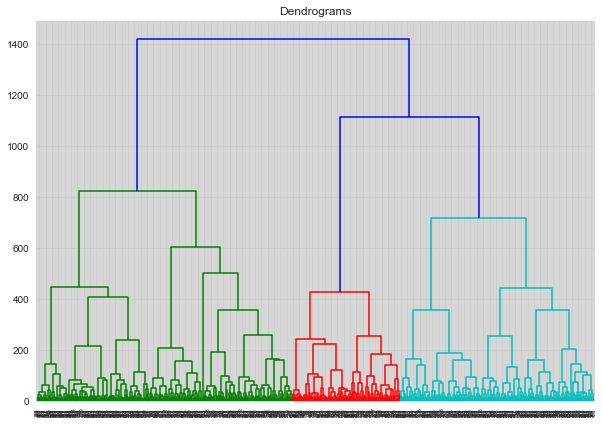

In [509]:
dendrogram_genetator(vec_df)

In [510]:
def dendrogram_genetator_with_thresold(df,thresold):
    plt.figure(figsize=(10, 7))
#     y=800
    plt.title("Dendrograms")  
    dend = shc.dendrogram(shc.linkage(df, method='ward'))
    plt.axhline(thresold, color='r', linestyle='--')
    


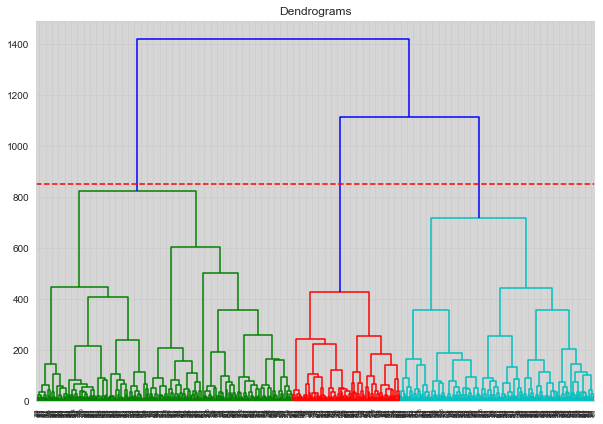

In [511]:
dendrogram_genetator_with_thresold(vec_df,850)

In [502]:
def hierarchial_clustering(df):
    cluster = AgglomerativeClustering(n_clusters=4, affinity='euclidean', linkage='ward')  
    cluster.fit_predict(df)
    
    plt.figure(figsize=(10, 7))  
    plt.scatter(df['ft1'], df['ft2'], c=cluster.labels_) 
    

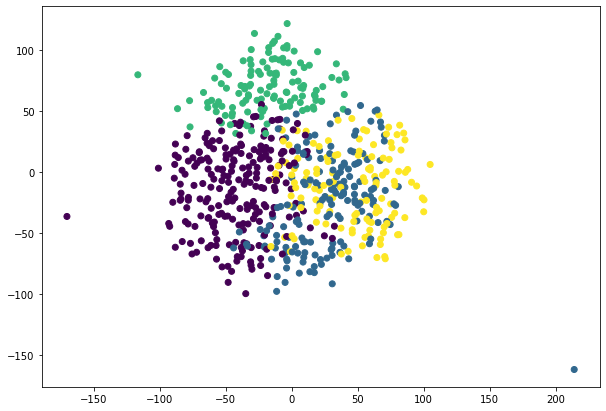

In [503]:
hierarchial_clustering(vec_df)

In [514]:
vec_df.set_index(negative_review_text_df["Review Text"], inplace = True) 
vec_df

,ft1,ft2,ft3
Review Text,,,
Very very bad app👿👿😡😡😠😠😤😤,50.910999,7.776887,-16.648796
Its a good aap but not understand as much as ...........😕😒👽,17.199387,-77.549202,-47.260593
my studentcontent is not coming I am so sad,0.196367,-4.648475,15.318274
Hi sir I am using old versions android mobile this not support please update,-59.893696,25.457123,40.971878
Bad,75.068085,-26.276560,36.354774
...,...,...,...
Very poor data n narration.,-22.848930,12.212592,-77.566368
"It is the worst app ever.the videos and content is not available.the videos are not played says""UNAVAILABLE VIDEO AND CONTENT"".please do not download this app.not at all satisfied.😠😡🤬",-19.629835,31.389803,-27.040134
Very bad,71.629730,0.015416,-7.155769


In [515]:
def cluster_element_extraction(vec_df):
    sns.set_palette('Set1', 10, 0.65)
    palette = (sns.color_palette())
    #set_link_color_palette(map(rgb2hex, palette))
    sns.set_style('white')
    
    np.random.seed(25)
    
    link = linkage(vec_df, metric='correlation', method='ward')

    figsize(8, 3)
    den = dendrogram(link, labels=vec_df.index)
    plt.xticks(rotation=90)
    no_spine = {'left': True, 'bottom': True, 'right': True, 'top': True}
    sns.despine(**no_spine);

    plt.tight_layout()
    plt.savefig('feb2.png');
    
    cluster_idxs = defaultdict(list)
    for c, pi in zip(den['color_list'], den['icoord']):
        for leg in pi[1:3]:
            i = (leg - 5.0) / 10.0
            if abs(i - int(i)) < 1e-5:
                cluster_idxs[c].append(int(i))
                
    class Clusters(dict):
        def _repr_html_(self):
            html = '<table style="border: 0;">'
            for c in self:
                hx = rgb2hex(colorConverter.to_rgb(c))
                html += '<tr style="border: 0;">' \
                '<td style="background-color: {0}; ' \
                           'border: 0;">' \
                '<code style="background-color: {0};">'.format(hx)
                html += c + '</code></td>'
                html += '<td style="border: 0"><code>' 
                html += repr(self[c]) + '</code>'
                html += '</td></tr>'

            html += '</table>'

            return html
    
    cluster_classes = Clusters()
    for c, l in cluster_idxs.items():
        i_l = [den['ivl'][i] for i in l]
        cluster_classes[c] = i_l
        
    return cluster_classes
    

/Users/tanyachauhan/myenv/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128544 missing from current font.

/Users/tanyachauhan/myenv/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128542 missing from current font.

/Users/tanyachauhan/myenv/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128560 missing from current font.

/Users/tanyachauhan/myenv/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128555 missing from current font.

/Users/tanyachauhan/myenv/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128545 missing from current font.

/Users/tanyachauhan/myenv/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128162 missing from current font.

/Users/tanyachauhan/myenv/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py

/Users/tanyachauhan/myenv/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128540 missing from current font.

/Users/tanyachauhan/myenv/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128420 missing from current font.

/Users/tanyachauhan/myenv/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128018 missing from current font.

/Users/tanyachauhan/myenv/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128529 missing from current font.

/Users/tanyachauhan/myenv/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 9201 missing from current font.

<ipython-input-515-b873e6abbf3f>:17: UserWarning:

Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 

/Users/tanyachauhan/myenv/lib/python3.8/site-packages/matplotlib/backen

/Users/tanyachauhan/myenv/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 128078 missing from current font.

/Users/tanyachauhan/myenv/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 128516 missing from current font.

/Users/tanyachauhan/myenv/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 128563 missing from current font.

/Users/tanyachauhan/myenv/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 128561 missing from current font.

/Users/tanyachauhan/myenv/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 128556 missing from current font.

/Users/tanyachauhan/myenv/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 128532 missing from current font.

/Users/tanyachauhan/myenv/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py

g
r


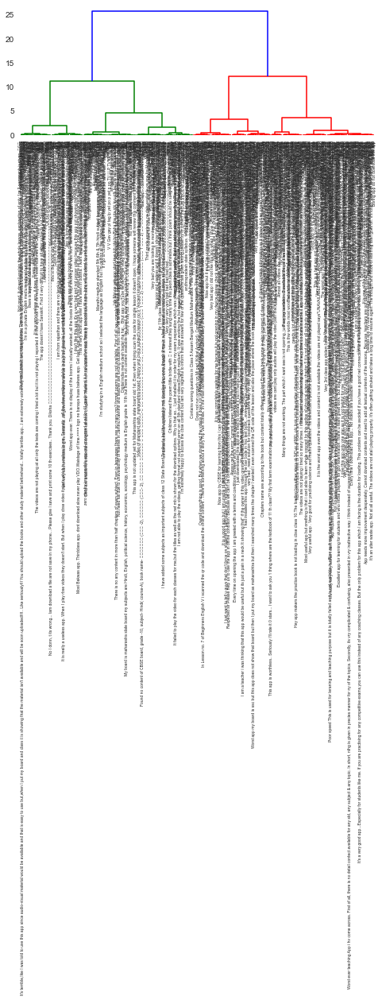

In [517]:
cluster_element_extraction(vec_df.head(3213))

In [379]:
new_neg_df = pd.DataFrame(columns=['Review Text', 'Keywords'])

for i in list_neg_review:
    if(i == ''):
        new_neg_df = new_neg_df.append({'Review Text': i, 'Keywords': '[]'}, ignore_index=True)
    else:
        x = phrase_extraction(i, grammar)
        new_neg_df = new_neg_df.append({'Review Text': i, 'Keywords': x}, ignore_index=True)

new_neg_df[0:50]
    

,Review Text,Keywords
0,Very very bad app👿👿😡😡😠😠😤😤,[bad app]
1,Its a good aap but not understand as much as ....,"[good aap, much]"
2,my studentcontent is not coming I am so sad,"[sad, studentcontent]"
3,Hi sir I am using old versions android mobile ...,"[, hi sir, old versions, please update]"
4,Bad,[bad]
5,Can I know the reason why there is no content ...,"[reason, , content, standard]"
6,😠😠😠😠😠,[]
7,I give this app only one star as it is not hel...,"[, worst app, app, helpful, answers, tell, tha..."
8,Useless they don't have video's what we want e...,"[, useless, every time]"
9,Bad,[bad]


In [382]:
neg_l=list(new_neg_df["Keywords"])
neg_l


[['bad app'],
 ['good aap', 'much'],
 ['sad', 'studentcontent'],
 ['', 'hi sir', 'old versions', 'please update'],
 ['bad'],
 ['reason', '', 'content', 'standard'],
 [],
 ['',
  'worst app',
  'app',
  'helpful',
  'answers',
  'tell',
  'thank',
  'star',
  'app diksha'],
 ['', 'useless', 'every time'],
 ['bad'],
 ['app', 'slow loading'],
 ['app'],
 ['', 'download', 'borring'],
 ['', 'irritating app'],
 ['', 'resent', 'wrong', 'otp'],
 ['app', 'useless', 'bad'],
 ['use'],
 ['2m', 'good'],
 ['hi miss'],
 ['app'],
 ['sums',
  'introduction',
  'chp',
  'topic',
  'thats',
  'doubtnut',
  'worstt',
  'maths'],
 ['', 'app'],
 ['descripe'],
 ['bad'],
 ['good app'],
 ['',
  'students',
  'angry',
  'force',
  'schools',
  'site',
  'self',
  'others',
  'anything',
  'guys',
  'stress'],
 ['bad'],
 ['', 'photo', 'video', 'bor appp', 'bad', 'learn'],
 ['app'],
 ['good', 'quality', 'features', 'happy', 'app lesson'],
 ['app', 'mobile'],
 ['bad'],
 ['app'],
 ['update information'],
 ['bad'],
 

In [383]:
list_neg_df=pd.DataFrame(neg_l)
neg_count=list_neg_df[0].value_counts()
neg_count[0:50]

                                              167
bad                                            68
app                                            52
good                                           23
waste                                          22
bad app                                        20
waste app                                       7
content                                         5
good app                                        4
poor                                            4
videos                                          4
bad experience                                  4
nice                                            4
appp                                            3
poor app                                        3
fake                                            3
video                                           3
use                                             3
contents                                        3
bad bad bad                                     2


In [486]:
import re
my_neg_list=list_neg_df[0].tolist()
my_neg_list
new_neg_list = [y.lower() for y in list_neg_review if re.search('material', y)]
new_neg_list


['not have class 11&12 material. useless app.',
 'there is no materials for the 11 and 12 th students.',
 "i had installed this app through the bar code in hsc text book....even after the commencement of our colleges it's not updated.....n has absolutely no material to study from.. if had n option wld have given a zero star rating",
 "it's terrible,like i was told to use this app since audio-visual material would be available and that is easy to use but,when i put my board and class it is showing that the material isn't available and will be soon uploaded!!!!.. like seriously!!! you should upload the books and other study material beforehand... totally terrible app...i am extremely extremely dissatisfied and disappointed with this app...!! i wanted maharashtra board,11th standard english medium!.,but it wasn't available!sorry",
 'worst material']

In [384]:
neu = final_df2.loc[final_df2['sentiment_class']=='Neutral']
neu_df = pd.DataFrame(neu)
neu_df[0:50]



,Review Text,pos_score,neg_score,neu_score,sentiment_class,Review Submit Date and Time,polarity,subjectivity,lower_desc
7,This app very usefull for students and teachers,0.0,0.0,1.0,Neutral,2019-06,0.200000,0.300000,<map object at 0x1406c4d60>
10,Not working on mobile even its android 7.3,0.0,0.0,1.0,Neutral,2019-06,0.000000,0.000000,<map object at 0x1406c4d60>
16,This is very importent for studes,0.0,0.0,1.0,Neutral,2019-06,0.200000,0.300000,<map object at 0x1406c4d60>
18,Unique,0.0,0.0,1.0,Neutral,2019-06,0.375000,1.000000,<map object at 0x1406c4d60>
25,Informative app with loads of learning materia...,0.0,0.0,1.0,Neutral,2019-06,0.278571,0.335714,<map object at 0x1406c4d60>
32,It is very use full,0.0,0.0,1.0,Neutral,2019-06,0.275000,0.425000,<map object at 0x1406c4d60>
33,I can't able to see the video I scanned the QR...,0.0,0.0,1.0,Neutral,2019-06,0.500000,0.562500,<map object at 0x1406c4d60>
41,Helfull teacher &students,0.0,0.0,1.0,Neutral,2019-06,0.000000,0.000000,<map object at 0x1406c4d60>
50,y8i,0.0,0.0,1.0,Neutral,2019-07,0.000000,0.000000,<map object at 0x1406c4d60>
54,Man,0.0,0.0,1.0,Neutral,2019-07,0.000000,0.000000,<map object at 0x1406c4d60>


In [385]:
from nltk.corpus import stopwords
stopwords = stopwords.words('english')
import re

def leaves(tree):
    """Finds NP (nounphrase) leaf nodes of a chunk tree."""
    for subtree in tree.subtrees(filter = lambda t: t.label()=='NP'):
       # The yield statement suspends function’s execution and sends a value back to the caller.
        yield subtree.leaves()

def acceptable_word(word):
    """Checks conditions for acceptable word: length, stopword."""
    accepted = bool(2 <= len(word) <= 40
                    and word.lower() not in stopwords)
    return accepted

def get_terms(tree):

    for leaf in leaves(tree):
        term = [ w for w,t in leaf if acceptable_word(w) ]
        yield term


In [386]:
grammar =r"""
  NP: {<DT|JJ|NN.*>+}          
  PP: {<IN><NP>}            
  VP: {<VB.*><NP|PP|CLAUSE>+$}
  CLAUSE: {<NP><VP>}          
  """
      
    

In [387]:
def phrase_extraction(text, grammar):
    text = text.lower()
    sentence_re = r'''(?x)          
      (?:[A-Z]\.)+        
    | \w+(?:-\w+)*        
    | \$?\d+(?:\.\d+)?%?  
    | \.\.\.              
    | [][.,;"'?():_`-]    
    '''
    
    ls = [] 
    word_token_ls = text.split(" ")

    toks = nltk.regexp_tokenize(text, sentence_re)
    postoks = nltk.tag.pos_tag(toks)
    
    chunker = nltk.RegexpParser(grammar)
    
    tree = chunker.parse(postoks)
    terms = get_terms(tree)
    for term in terms:
        ls.append(" ".join(term)) 
    return list(set(ls))



In [388]:
list_neu_review= list(neu_df["Review Text"])
print(list_neu_review)

['This app very usefull for students and teachers', 'Not working on mobile even its android 7.3', 'This is very importent for studes', 'Unique', 'Informative app with loads of learning materials specially for teachers who wants to enhance their knowledge.', 'It is very use full', "I can't able to see the video I scanned the QR code many times but the video is not displaying", 'Helfull teacher &students', 'y8i', 'Man', 'शिक्षकांचा मित्र', 'बहुत अच्छा विषय प्रस्तुत की जा रही हैं।', 'Disc H DVD', 'I can use this app any where without use of any books', 'Very excelent', 'खूप सुंदर! शिक्षक,पालक व विद्यार्थ्यांसाठी अतिशय उपयुक्त आहे.', '👍👍', 'Usefull to d.s.c exams', 'Add to all subject', "QR CODE ISN'T WORKING CORRECTLY .....SAID TO ME ,'' YOUR STATE WILL SOON ADD CONTENT FOR THIS QR CODE. IT WILL BE AVAILABLE SHORTLY.'' Why??", 'Didi', '👍👍good app', 'Wast app not coming properly', 'Gd', 'DIKSHA _ National', 'It was usefull for children .', 'Cycle Diksha', 'Arun Kashyap And Vk', 'All in one

In [389]:
new_neu_df = pd.DataFrame(columns=['Review Text', 'Keywords'])

for i in list_neu_review:
    if(i == ''):
        new_neu_df = new_neu_df.append({'Review Text': i, 'Keywords': '[]'}, ignore_index=True)
    else:
        x = phrase_extraction(i, grammar)
        new_neu_df = new_neu_df.append({'Review Text': i, 'Keywords': x}, ignore_index=True)

new_neu_df[0:50]
    

,Review Text,Keywords
0,This app very usefull for students and teachers,"[app, students, teachers, usefull]"
1,Not working on mobile even its android 7.3,"[android, mobile]"
2,This is very importent for studes,"[, studes, importent]"
3,Unique,[unique]
4,Informative app with loads of learning materia...,"[informative app, loads, knowledge, teachers, ..."
5,It is very use full,[use full]
6,I can't able to see the video I scanned the QR...,"[, video, able, qr code many times]"
7,Helfull teacher &students,[helfull teacher students]
8,y8i,[y8i]
9,Man,[man]


In [391]:
neu_l=list(new_neu_df["Keywords"])
neu_l

[['app', 'students', 'teachers', 'usefull'],
 ['android', 'mobile'],
 ['', 'studes', 'importent'],
 ['unique'],
 ['informative app', 'loads', 'knowledge', 'teachers', 'materials'],
 ['use full'],
 ['', 'video', 'able', 'qr code many times'],
 ['helfull teacher students'],
 ['y8i'],
 ['man'],
 ['षक'],
 ['बह अच षय रस रह'],
 ['disc dvd'],
 ['', 'app', 'use', 'books'],
 ['excelent'],
 ['लक अत शय उपय आह', 'दर षक'],
 [],
 ['', 'exams', 'usefull'],
 ['subject'],
 ['', 'available', 'qr code', 'content', 'state'],
 ['didi'],
 ['good app'],
 ['wast'],
 ['gd'],
 ['national', 'diksha'],
 ['children', 'usefull'],
 ['cycle diksha'],
 ['arun kashyap', 'vk'],
 [''],
 [],
 ['vool'],
 [],
 [],
 ['kkkk'],
 [],
 ['narayna'],
 ['ஒர ணவன எனக பயன ளத இர'],
 ['class'],
 ['subject'],
 ['പർ'],
 ['bihola anchal'],
 ['install'],
 ['pd'],
 ['षण बह उपय नक', 'इसस हम अध पक नय षय पढ़ बह गमत'],
 ['बच सह यक'],
 ['exellent बह अच'],
 ['third class'],
 ['book covers', 'classes'],
 ['topices', 'maximum videos'],
 ['exallent'],

In [392]:
list_neu_df=pd.DataFrame(neu_l)
neu_count=list_neu_df[0].value_counts()
neu_count[0:50]

                245
app             102
supper           37
use full         17
diksha           16
usefull app      15
supper app       12
students         11
full             11
video            10
student          10
usefull           9
diksha app        9
videos            9
mast              9
books             8
teachers          8
need              7
excelent          7
full app          7
study             7
class             7
osm               6
open              6
பர                6
nyc               6
content           6
exlent            5
supar             5
use               5
gud               5
nise              5
knowledge         5
work              4
use ful           4
நன                4
contents          4
helpfull          4
teacher           4
dlksha            4
spr               4
oooo              3
karthik           3
learning          3
children          3
wast              3
average           3
new syllabus      3
बह दर             3
yash              3


In [393]:
# event_dictionary ={'Positive' : >0.5, 'Neutral' : 0.5, 'Negative' : <0.5} 
  
# # Add a new column named 'Price' 
# final_df2['polarity'] = final_df2['sentiment_class'].map(event_dictionary) 
  
# # Print the DataFrame 
# print(final_df2)

final_df2["sentiment_class"].value_counts()



Positive    8811
Neutral     2397
Negative     646
Name: sentiment_class, dtype: int64

In [148]:
# final_df2["polarity"].value_counts()
# final_df2['polarity'].value_counts(normalize=False, sort=True, ascending=False, bins=None, dropna=True)

final_df2["polarity"].describe()


count    11854.000000
mean         0.405518
std          0.376342
min         -1.000000
25%          0.000000
50%          0.433333
75%          0.700000
max          1.000000
Name: polarity, dtype: float64

In [316]:
final_df2["sentiment_class"].describe()


count        11854
unique           3
top       Positive
freq          8811
Name: sentiment_class, dtype: object

In [317]:
# final_df2["Review Text"]=["Review Text"].str.lower()

# final_df2



In [318]:
# a=final_df2["Review Text"].value_counts()
# a[0:50]

In [319]:
final_df2["Review Text"].describe()


count     11854
unique     7830
top        Good
freq        504
Name: Review Text, dtype: object

In [320]:
mylist=final_df2["Review Text"].tolist()


In [321]:
out = map(lambda x:x.lower(), mylist)
output = list(out)
print(output)
 

['good but not much', 'good application', 'nice explanation', 'best app 4 students', 'ok', 'excellent', 'ok', 'this app very usefull for students and teachers', 'good', 'wow amazing', 'not working on mobile even its android 7.3', 'very very bad app👿👿😡😡😠😠😤😤', 'easy to learn', 'excellent', 'very good app. i am a secondary school teacher, & i notice dixa doing smart work.... i would like to do my little contribute...', 'it is very useful', 'this is very importent for studes', 'excellent', 'unique', 'it is a good app for leaning', 'it is very helpful to us', 'super teaching', 'how to use it all book are in marathi or gujarat l had all in english language please', '👌👌', 'good application', 'informative app with loads of learning materials specially for teachers who wants to enhance their knowledge.', 'very good app', 'this app is a great help to learn maths.it is extraordinary.', 'the app is very useful to you and all students', 'this app very helpful for students and teachers..', 'useful l

In [322]:
# a=final_df2["Review Text"].value_counts()
# a[0:50]

lowerdata=pd.DataFrame(output)
lowerdata[0].value_counts()

good                                                                            786
nice                                                                            497
super                                                                           424
nice app                                                                        264
good app                                                                        165
                                                                               ... 
superb explaining app for 10th class                                              1
i'm about a lot of information in this app thank you diksha                       1
outstanding app hdydyxy                                                           1
very goof                                                                         1
awesome. this way of teaching the class is more interesting but sound is low      1
Name: 0, Length: 7485, dtype: int64

In [404]:
import re
my_list=lowerdata[0].tolist()
new_list = [x.lower() for x in mylist if re.search("problems", x)]
new_list
# for item in new_list:
#     print(item)

['good life skill problems',
 'ok.. first up all thanks.. it is a good app. but whenever i start to open a video for biology or chemistry in the screen not arriving the video but sound is coming in doubled ways... i liked.. make it sure that others are not feel this kinds of problems... ok if it is playing well i should write my words with good and put full rating stars... ok thank you...😃👍',
 'this is the best app to solve our problems',
 'give more applications level problems on mesuration trigonometry ap & science 4&5 marks questions & try to add all subjects sir',
 'the app is really lagging and wastes time .there are no detailed questions from the chapters .please do correct these problems',
 'good but if this app could be like solving problems kind of that;it would be the best 🤘',
 'many problems at loading videos',
 'please help the app is crashing when l open it creating problems in my phone stirage',
 'leading content problems😰',
 "i loved this app very much. my learning exper

In [338]:
def CountFrequency(new_list): 
  
    # Creating an empty dictionary  
    freq = {} 
    for item in new_list: 
        if (item in freq): 
            freq[item] += 1
        else: 
            freq[item] = 1
  
    for key, value in freq.items(): 
        print(key,":", value) 
CountFrequency(new_list) 

good life skill problems : 1
ok.. first up all thanks.. it is a good app. but whenever i start to open a video for biology or chemistry in the screen not arriving the video but sound is coming in doubled ways... i liked.. make it sure that others are not feel this kinds of problems... ok if it is playing well i should write my words with good and put full rating stars... ok thank you...😃👍 : 1
this is the best app to solve our problems : 1
give more applications level problems on mesuration trigonometry ap & science 4&5 marks questions & try to add all subjects sir : 1
the app is really lagging and wastes time .there are no detailed questions from the chapters .please do correct these problems : 1
good but if this app could be like solving problems kind of that;it would be the best 🤘 : 1
many problems at loading videos : 1
please help the app is crashing when l open it creating problems in my phone stirage : 1
leading content problems😰 : 1
i loved this app very much. my learning experie

In [325]:
final_df2.to_csv('/Users/tanyachauhan/Documents/Diksha_Sentiments_Analysis.csv', index = False, header=True)
final_df2

,Review Text,pos_score,neg_score,neu_score,sentiment_class,Review Submit Date and Time,polarity,subjectivity,lower_desc
0,good but not much,0.394,0.00,0.606,Positive,2018-07,0.300000,0.400000,<map object at 0x1406c4d60>
1,Good application,0.744,0.00,0.256,Positive,2018-09,0.700000,0.600000,<map object at 0x1406c4d60>
2,Nice explanation,0.737,0.00,0.263,Positive,2018-12,0.600000,1.000000,<map object at 0x1406c4d60>
3,Best app 4 students,0.583,0.00,0.417,Positive,2018-12,1.000000,0.300000,<map object at 0x1406c4d60>
4,ok,1.000,0.00,0.000,Positive,2019-03,0.500000,0.500000,<map object at 0x1406c4d60>
...,...,...,...,...,...,...,...,...,...
11849,Sadanand Kushwaha,0.000,0.00,1.000,Neutral,2020-03,0.000000,0.000000,<map object at 0x1406c4d60>
11850,I am a student . It is very good app but its p...,0.169,0.15,0.681,Negative,2020-03,0.503333,0.493333,<map object at 0x1406c4d60>
11851,Well app,0.677,0.00,0.323,Positive,2020-03,0.000000,0.000000,<map object at 0x1406c4d60>
11852,Nice video,0.737,0.00,0.263,Positive,2020-03,0.600000,1.000000,<map object at 0x1406c4d60>


In [36]:
# reviewdf = final_df["Keywords"]
# reviewdf


In [83]:
def wordcloud_generator(reviewdf):
    comment_words = ' '
    stopwords = set(STOPWORDS) 
    for val in reviewdf: 
        val = str(val) 

        # split the value 
        tokens = val.split() 

        # Converts each token into lowercase 
        for i in range(len(tokens)): 
            tokens[i] = tokens[i].lower() 

        for words in tokens: 
            comment_words = comment_words + words + ' '

    wordcloud = WordCloud(width = 800, height = 800, 
    background_color = 'white', 
    stopwords = stopwords, 
    min_font_size = 10).generate(comment_words) 

    plt.figure(figsize = (8, 8), facecolor = None) 
    plt.imshow(wordcloud) 
    plt.axis("off") 
    plt.tight_layout(pad = 0) 

    plt.show()
    

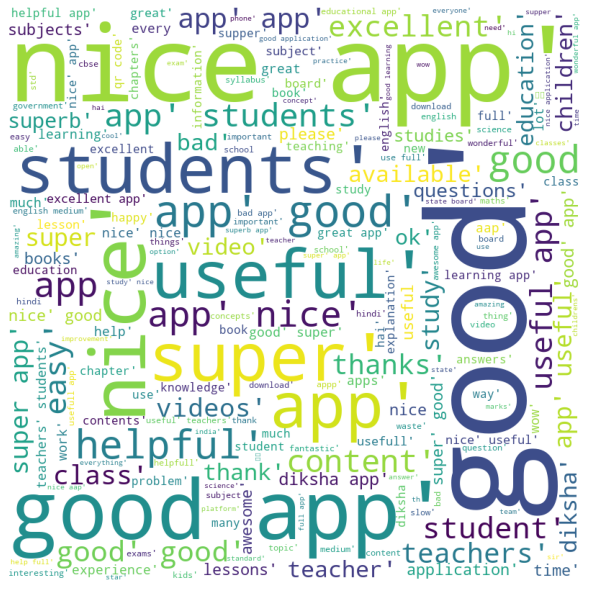

In [84]:
wordcloud_generator(reviewdf)

In [85]:
def sentiment_graph_for_each_rating(df):
    g = sns.FacetGrid(df, col = "sentiment_class")
    g.map(plt.hist, "Star Rating")
    plt.show()

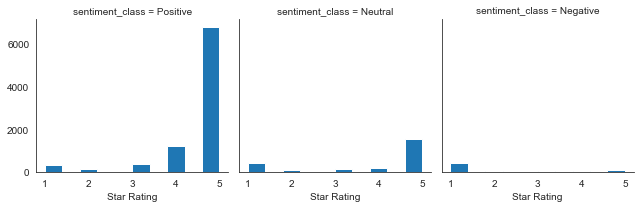

In [86]:
sentiment_graph_for_each_rating(final_df2)

In [87]:
def vectorization_of_list(keyword_list):
    #word embedding(vectorization)
    embed = hub.Module("/Users/rishabhsrivastava/Downloads/vectorization_trained_dataset/")
    tf.logging.set_verbosity(tf.logging.ERROR)
    with tf.Session() as session:
        session.run([tf.global_variables_initializer(), tf.tables_initializer()])
        message_embeddings = session.run(embed(keyword_list))
#         print(message_embeddings)
        lst = []
        for i in message_embeddings:
            df = pd.DataFrame([i])
            lst.append(df)
    frame = pd.concat(lst)
    return frame


In [88]:
frame = vectorization_of_list(kywrd_ls)
frame

,0,1,2,3,4,5,6,7,8,9,...,502,503,504,505,506,507,508,509,510,511
0,0.056652,-0.014057,-0.051603,0.036374,-0.050826,-0.048202,-0.058168,0.040853,-0.056088,0.063263,...,-0.052873,0.020644,0.022686,-0.055611,-0.059845,-0.038390,-0.037953,0.016061,0.061576,0.010814
0,0.036576,0.016622,0.073020,0.006586,0.006936,0.047375,-0.039865,-0.032226,-0.118987,0.017532,...,-0.014702,0.051671,-0.002312,-0.013568,-0.087983,-0.049924,-0.009444,-0.026646,0.012935,-0.017673
0,0.052116,-0.037193,-0.015949,0.011238,-0.097456,-0.001689,-0.082167,-0.016200,-0.051691,0.063787,...,-0.084465,0.039110,0.021774,-0.042758,0.063692,0.025335,0.043251,0.020754,-0.047188,0.035535
0,0.043165,0.034812,-0.049839,0.023642,-0.103671,0.012217,-0.028746,0.047570,-0.045471,0.031333,...,0.028066,0.002867,0.004317,-0.044547,0.042612,-0.001712,0.031697,-0.039286,0.011131,0.028831
0,0.014341,0.002033,-0.018820,-0.028571,0.014882,0.015126,0.037195,-0.002979,-0.123778,0.036126,...,-0.060729,0.040420,-0.025900,-0.103708,0.003107,0.055031,-0.050226,-0.025407,-0.030576,0.038003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,-0.062077,0.064613,0.002178,0.011396,-0.028838,-0.027942,0.004127,-0.007783,-0.079684,-0.018675,...,0.004078,0.030807,-0.024605,-0.060878,-0.066309,-0.073336,-0.001855,-0.007214,-0.031448,0.009431
0,0.004083,0.012760,0.019549,-0.009849,-0.029969,0.052597,-0.018666,-0.053677,-0.133354,0.021780,...,0.018547,0.027469,-0.048300,-0.034561,0.013192,-0.007606,0.037111,-0.003608,-0.026493,-0.027270
0,0.058894,-0.041074,0.003611,-0.009901,-0.107958,0.063119,-0.040064,-0.002207,-0.100545,0.038066,...,0.070757,0.045112,0.034418,-0.054590,0.050784,-0.006289,0.018796,0.049680,-0.012496,0.015860
0,0.004098,0.060215,0.042553,0.027844,-0.021144,-0.046967,-0.063360,0.010955,-0.102758,-0.011094,...,0.012273,0.014194,0.071566,-0.005770,-0.012771,0.016296,-0.072261,0.006698,0.023631,0.023863


In [127]:
review_frame = vectorization_of_list(review_df_ls)
review_frame

,0,1,2,3,4,5,6,7,8,9,...,502,503,504,505,506,507,508,509,510,511
0,0.055982,-0.017043,-0.026179,0.037333,-0.013559,-0.098867,0.022987,0.021312,-0.099767,0.053197,...,-0.053791,0.001333,0.001894,0.044040,0.000194,-0.042587,0.002510,0.009586,0.042787,-0.043543
0,0.014840,-0.014234,0.066757,-0.037582,-0.055805,-0.035152,-0.026674,-0.024049,-0.105548,-0.005871,...,-0.073546,-0.042377,0.006247,-0.051611,-0.044807,-0.042842,-0.029408,-0.040896,0.005703,0.032952
0,0.007920,0.050671,0.049252,0.040677,-0.028911,-0.043485,-0.050014,0.010752,-0.087651,-0.038163,...,0.036878,0.034901,0.055260,-0.021814,-0.028495,0.023605,-0.069751,0.023436,0.049316,0.026621
0,-0.011144,-0.034664,0.000190,-0.009187,-0.049305,0.003864,0.045029,0.064180,-0.028784,-0.024996,...,-0.114351,-0.052884,0.005621,-0.042811,0.005816,-0.008924,0.010848,-0.045674,0.021329,-0.015369
0,0.029081,0.024024,0.030125,-0.015359,-0.026184,0.044901,-0.045168,0.005992,-0.122194,-0.012099,...,0.044723,-0.003204,-0.004798,0.035042,-0.007052,0.016333,0.020266,0.017800,-0.024658,-0.023926
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,0.025002,0.006011,0.035900,-0.037064,-0.011638,0.002013,-0.026393,-0.011234,-0.127052,0.034218,...,-0.012846,-0.002640,0.021031,0.000410,-0.061871,-0.042006,0.009918,-0.003402,-0.024646,-0.020193
0,0.037279,-0.008789,0.035140,-0.059665,-0.010733,-0.029395,-0.043877,0.019714,-0.132643,0.029957,...,-0.014904,0.024277,0.046475,0.018207,-0.022981,-0.026886,0.047292,-0.034510,-0.023787,0.022487
0,-0.038959,0.027463,-0.053166,0.085852,-0.080917,0.038211,-0.018111,0.052875,-0.013517,0.026766,...,-0.079140,-0.094696,-0.040593,0.048615,-0.024580,-0.020150,-0.011108,-0.084329,-0.021028,-0.028807
0,0.027274,-0.038744,0.009095,-0.034673,-0.010595,0.009089,-0.034059,0.000415,-0.118752,0.043559,...,-0.026746,-0.001104,0.021728,-0.051475,-0.076227,-0.041930,0.014702,0.025081,0.009765,0.002321


In [128]:
review_text_df = pd.DataFrame(review_df_ls,columns=['Review Text'])
review_text_df

,Review Text
0,good but not much
1,Good application
2,Nice explanation
3,Best app 4 students
4,ok
...,...
11849,excelent..
11850,super and excellent and extraordinariy
11851,i had installed this app through the bar code ...
11852,superb


In [129]:
review_frame.set_index(review_text_df["Review Text"], inplace = True) 


In [131]:
review_frame

,0,1,2,3,4,5,6,7,8,9,...,502,503,504,505,506,507,508,509,510,511
Review Text,,,,,,,,,,,,,,,,,,,,,
good but not much,0.055982,-0.017043,-0.026179,0.037333,-0.013559,-0.098867,0.022987,0.021312,-0.099767,0.053197,...,-0.053791,0.001333,0.001894,0.044040,0.000194,-0.042587,0.002510,0.009586,0.042787,-0.043543
Good application,0.014840,-0.014234,0.066757,-0.037582,-0.055805,-0.035152,-0.026674,-0.024049,-0.105548,-0.005871,...,-0.073546,-0.042377,0.006247,-0.051611,-0.044807,-0.042842,-0.029408,-0.040896,0.005703,0.032952
Nice explanation,0.007920,0.050671,0.049252,0.040677,-0.028911,-0.043485,-0.050014,0.010752,-0.087651,-0.038163,...,0.036878,0.034901,0.055260,-0.021814,-0.028495,0.023605,-0.069751,0.023436,0.049316,0.026621
Best app 4 students,-0.011144,-0.034664,0.000190,-0.009187,-0.049305,0.003864,0.045029,0.064180,-0.028784,-0.024996,...,-0.114351,-0.052884,0.005621,-0.042811,0.005816,-0.008924,0.010848,-0.045674,0.021329,-0.015369
ok,0.029081,0.024024,0.030125,-0.015359,-0.026184,0.044901,-0.045168,0.005992,-0.122194,-0.012099,...,0.044723,-0.003204,-0.004798,0.035042,-0.007052,0.016333,0.020266,0.017800,-0.024658,-0.023926
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
excelent..,0.025002,0.006011,0.035900,-0.037064,-0.011638,0.002013,-0.026393,-0.011234,-0.127052,0.034218,...,-0.012846,-0.002640,0.021031,0.000410,-0.061871,-0.042006,0.009918,-0.003402,-0.024646,-0.020193
super and excellent and extraordinariy,0.037279,-0.008789,0.035140,-0.059665,-0.010733,-0.029395,-0.043877,0.019714,-0.132643,0.029957,...,-0.014904,0.024277,0.046475,0.018207,-0.022981,-0.026886,0.047292,-0.034510,-0.023787,0.022487
i had installed this app through the bar code in hsc text book....even after the commencement of our colleges it's not updated.....n has absolutely no material to study from.. if had n option wld have given a zero star rating,-0.038959,0.027463,-0.053166,0.085852,-0.080917,0.038211,-0.018111,0.052875,-0.013517,0.026766,...,-0.079140,-0.094696,-0.040593,0.048615,-0.024580,-0.020150,-0.011108,-0.084329,-0.021028,-0.028807


In [130]:
review_frame.to_csv ('/Users/rishabhsrivastava/Downloads/CSVS/Vectorized_review_text.csv', index = False, header=True)


In [89]:
keywordsdf = pd.DataFrame(kywrd_ls,columns=['keywords'])
keywordsdf

,keywords
0,
1,fun
2,maharashtra state board english medium1st stan...
3,telugu medium
4,update requring
...,...
6011,excellent system
6012,hkg
6013,அப பட diksha யல மட உபய பட
6014,excellent explanation


In [90]:
frame.set_index(keywordsdf["keywords"], inplace = True) 
frame

,0,1,2,3,4,5,6,7,8,9,...,502,503,504,505,506,507,508,509,510,511
keywords,,,,,,,,,,,,,,,,,,,,,
,0.056652,-0.014057,-0.051603,0.036374,-0.050826,-0.048202,-0.058168,0.040853,-0.056088,0.063263,...,-0.052873,0.020644,0.022686,-0.055611,-0.059845,-0.038390,-0.037953,0.016061,0.061576,0.010814
fun,0.036576,0.016622,0.073020,0.006586,0.006936,0.047375,-0.039865,-0.032226,-0.118987,0.017532,...,-0.014702,0.051671,-0.002312,-0.013568,-0.087983,-0.049924,-0.009444,-0.026646,0.012935,-0.017673
maharashtra state board english medium1st standerd,0.052116,-0.037193,-0.015949,0.011238,-0.097456,-0.001689,-0.082167,-0.016200,-0.051691,0.063787,...,-0.084465,0.039110,0.021774,-0.042758,0.063692,0.025335,0.043251,0.020754,-0.047188,0.035535
telugu medium,0.043165,0.034812,-0.049839,0.023642,-0.103671,0.012217,-0.028746,0.047570,-0.045471,0.031333,...,0.028066,0.002867,0.004317,-0.044547,0.042612,-0.001712,0.031697,-0.039286,0.011131,0.028831
update requring,0.014341,0.002033,-0.018820,-0.028571,0.014882,0.015126,0.037195,-0.002979,-0.123778,0.036126,...,-0.060729,0.040420,-0.025900,-0.103708,0.003107,0.055031,-0.050226,-0.025407,-0.030576,0.038003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
excellent system,-0.062077,0.064613,0.002178,0.011396,-0.028838,-0.027942,0.004127,-0.007783,-0.079684,-0.018675,...,0.004078,0.030807,-0.024605,-0.060878,-0.066309,-0.073336,-0.001855,-0.007214,-0.031448,0.009431
hkg,0.004083,0.012760,0.019549,-0.009849,-0.029969,0.052597,-0.018666,-0.053677,-0.133354,0.021780,...,0.018547,0.027469,-0.048300,-0.034561,0.013192,-0.007606,0.037111,-0.003608,-0.026493,-0.027270
அப பட diksha யல மட உபய பட,0.058894,-0.041074,0.003611,-0.009901,-0.107958,0.063119,-0.040064,-0.002207,-0.100545,0.038066,...,0.070757,0.045112,0.034418,-0.054590,0.050784,-0.006289,0.018796,0.049680,-0.012496,0.015860


In [91]:
def TSNE_3D(df):
    %pylab inline 

    #Reduce Dimensinality
    X_embedded = TSNE(n_components=3).fit_transform(df)
    vec_df = pd.DataFrame(X_embedded, columns=["ft1","ft2","ft3"])
    #vec_df
    #plot 3-D graph
    fig = px.scatter_3d(vec_df,x="ft1",y="ft2",z="ft3")
    fig.show()

In [92]:
TSNE_3D(frame)

Populating the interactive namespace from numpy and matplotlib


In [132]:
TSNE_3D(review_frame)

Populating the interactive namespace from numpy and matplotlib


In [93]:
# frame.insert(512,"keywords",frame.index)
# frame.reset_index(drop=True, inplace=True)

In [94]:
# frame["keywords"]

In [97]:
def dendrogram_genetator(df):
    plt.figure(figsize=(10, 7))  
    plt.title("Dendrograms")  
    dend = shc.dendrogram(shc.linkage(df, method='ward'))
    

In [98]:
frame

,0,1,2,3,4,5,6,7,8,9,...,502,503,504,505,506,507,508,509,510,511
keywords,,,,,,,,,,,,,,,,,,,,,
,0.056652,-0.014057,-0.051603,0.036374,-0.050826,-0.048202,-0.058168,0.040853,-0.056088,0.063263,...,-0.052873,0.020644,0.022686,-0.055611,-0.059845,-0.038390,-0.037953,0.016061,0.061576,0.010814
fun,0.036576,0.016622,0.073020,0.006586,0.006936,0.047375,-0.039865,-0.032226,-0.118987,0.017532,...,-0.014702,0.051671,-0.002312,-0.013568,-0.087983,-0.049924,-0.009444,-0.026646,0.012935,-0.017673
maharashtra state board english medium1st standerd,0.052116,-0.037193,-0.015949,0.011238,-0.097456,-0.001689,-0.082167,-0.016200,-0.051691,0.063787,...,-0.084465,0.039110,0.021774,-0.042758,0.063692,0.025335,0.043251,0.020754,-0.047188,0.035535
telugu medium,0.043165,0.034812,-0.049839,0.023642,-0.103671,0.012217,-0.028746,0.047570,-0.045471,0.031333,...,0.028066,0.002867,0.004317,-0.044547,0.042612,-0.001712,0.031697,-0.039286,0.011131,0.028831
update requring,0.014341,0.002033,-0.018820,-0.028571,0.014882,0.015126,0.037195,-0.002979,-0.123778,0.036126,...,-0.060729,0.040420,-0.025900,-0.103708,0.003107,0.055031,-0.050226,-0.025407,-0.030576,0.038003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
excellent system,-0.062077,0.064613,0.002178,0.011396,-0.028838,-0.027942,0.004127,-0.007783,-0.079684,-0.018675,...,0.004078,0.030807,-0.024605,-0.060878,-0.066309,-0.073336,-0.001855,-0.007214,-0.031448,0.009431
hkg,0.004083,0.012760,0.019549,-0.009849,-0.029969,0.052597,-0.018666,-0.053677,-0.133354,0.021780,...,0.018547,0.027469,-0.048300,-0.034561,0.013192,-0.007606,0.037111,-0.003608,-0.026493,-0.027270
அப பட diksha யல மட உபய பட,0.058894,-0.041074,0.003611,-0.009901,-0.107958,0.063119,-0.040064,-0.002207,-0.100545,0.038066,...,0.070757,0.045112,0.034418,-0.054590,0.050784,-0.006289,0.018796,0.049680,-0.012496,0.015860


In [99]:
%pylab inline
#Reduce Dimensinality
X_embedded = TSNE(n_components=3).fit_transform(frame)
vec_df = pd.DataFrame(X_embedded, columns=["ft1","ft2","ft3"])
vec_df

Populating the interactive namespace from numpy and matplotlib


,ft1,ft2,ft3
0,-8.435359,-21.347582,-8.728216
1,0.645464,-25.201380,1.561404
2,0.734187,21.921770,5.317109
3,9.526357,20.930939,6.552406
4,-18.665581,-12.626808,-0.224515
...,...,...,...
6011,-8.843647,-26.639956,3.958358
6012,7.513927,3.734592,-9.287310
6013,16.990677,20.793522,-17.450869
6014,-3.074533,-16.490772,18.138258


In [133]:
%pylab inline
#Reduce Dimensinality
X_embedded = TSNE(n_components=3).fit_transform(review_frame)
review_vec_df = pd.DataFrame(X_embedded, columns=["ft1","ft2","ft3"])
review_vec_df

Populating the interactive namespace from numpy and matplotlib


,ft1,ft2,ft3
0,22.588146,9.539480,-3.963582
1,-2.996399,-16.396055,-8.659514
2,8.829664,-2.207439,-6.501996
3,-4.673175,-11.985705,-23.966370
4,8.505477,-2.719784,15.342266
...,...,...,...
11849,16.552507,-2.123943,16.989519
11850,22.366224,-6.464561,6.369094
11851,-4.958005,6.003526,-7.823398
11852,23.240885,-12.623316,5.069547


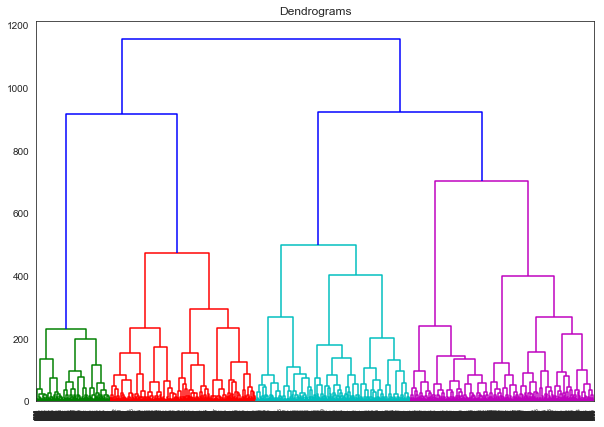

In [103]:
dendrogram_genetator(vec_df)

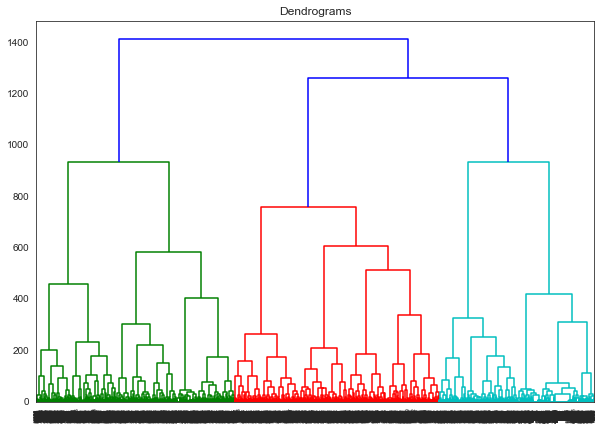

In [134]:
dendrogram_genetator(review_vec_df)

In [106]:
def dendrogram_genetator_with_thresold(df,thresold):
    plt.figure(figsize=(10, 7))
#     y=800
    plt.title("Dendrograms")  
    dend = shc.dendrogram(shc.linkage(df, method='ward'))
    plt.axhline(thresold, color='r', linestyle='--')
    


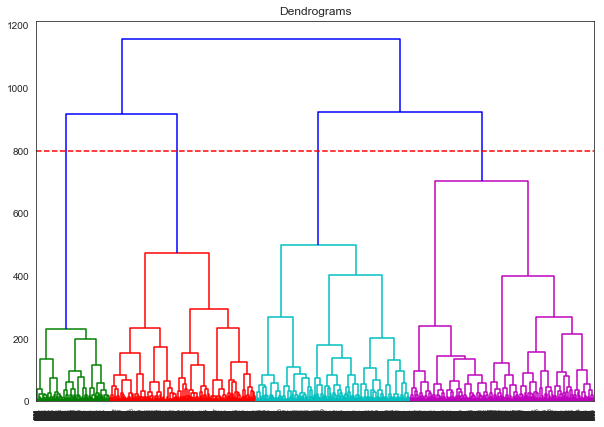

In [137]:
dendrogram_genetator_with_thresold(vec_df,800)

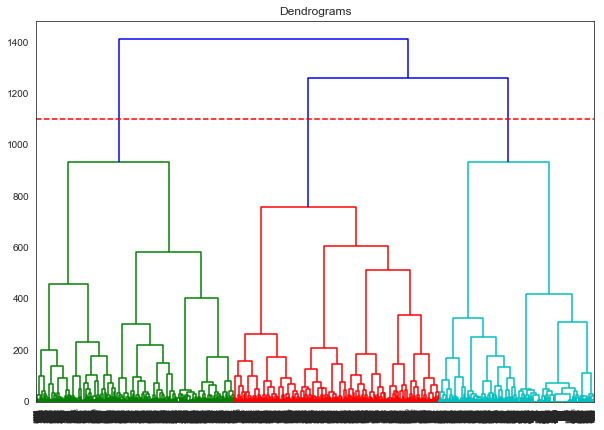

In [136]:
dendrogram_genetator_with_thresold(review_vec_df,1100)

In [108]:
def hierarchial_clustering(df):
    cluster = AgglomerativeClustering(n_clusters=4, affinity='euclidean', linkage='ward')  
    cluster.fit_predict(df)
    
    plt.figure(figsize=(10, 7))  
    plt.scatter(df['ft1'], df['ft2'], c=cluster.labels_) 
    

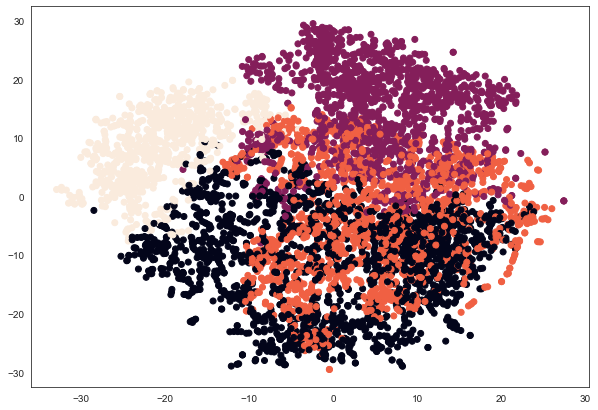

In [109]:
hierarchial_clustering(vec_df)

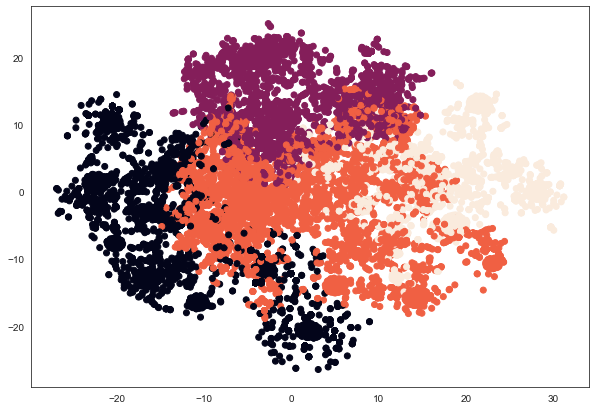

In [138]:
hierarchial_clustering(review_vec_df)

In [110]:
#result.reset_index(drop=True, inplace=True)
vec_df.set_index(keywordsdf["keywords"], inplace = True) 
vec_df

,ft1,ft2,ft3
keywords,,,
,-8.435359,-21.347582,-8.728216
fun,0.645464,-25.201380,1.561404
maharashtra state board english medium1st standerd,0.734187,21.921770,5.317109
telugu medium,9.526357,20.930939,6.552406
update requring,-18.665581,-12.626808,-0.224515
...,...,...,...
excellent system,-8.843647,-26.639956,3.958358
hkg,7.513927,3.734592,-9.287310
அப பட diksha யல மட உபய பட,16.990677,20.793522,-17.450869


In [139]:
#result.reset_index(drop=True, inplace=True)
review_vec_df.set_index(review_text_df["Review Text"], inplace = True) 
review_vec_df

,ft1,ft2,ft3
Review Text,,,
good but not much,22.588146,9.539480,-3.963582
Good application,-2.996399,-16.396055,-8.659514
Nice explanation,8.829664,-2.207439,-6.501996
Best app 4 students,-4.673175,-11.985705,-23.966370
ok,8.505477,-2.719784,15.342266
...,...,...,...
excelent..,16.552507,-2.123943,16.989519
super and excellent and extraordinariy,22.366224,-6.464561,6.369094
i had installed this app through the bar code in hsc text book....even after the commencement of our colleges it's not updated.....n has absolutely no material to study from.. if had n option wld have given a zero star rating,-4.958005,6.003526,-7.823398


In [111]:
def cluster_element_extraction(vec_df):
    sns.set_palette('Set1', 10, 0.65)
    palette = (sns.color_palette())
    #set_link_color_palette(map(rgb2hex, palette))
    sns.set_style('white')
    
    np.random.seed(25)
    
    link = linkage(vec_df, metric='correlation', method='ward')

    figsize(8, 3)
    den = dendrogram(link, labels=vec_df.index)
    plt.xticks(rotation=90)
    no_spine = {'left': True, 'bottom': True, 'right': True, 'top': True}
    sns.despine(**no_spine);

    plt.tight_layout()
    plt.savefig('feb2.png');
    
    cluster_idxs = defaultdict(list)
    for c, pi in zip(den['color_list'], den['icoord']):
        for leg in pi[1:3]:
            i = (leg - 5.0) / 10.0
            if abs(i - int(i)) < 1e-5:
                cluster_idxs[c].append(int(i))
                
    class Clusters(dict):
        def _repr_html_(self):
            html = '<table style="border: 0;">'
            for c in self:
                hx = rgb2hex(colorConverter.to_rgb(c))
                html += '<tr style="border: 0;">' \
                '<td style="background-color: {0}; ' \
                           'border: 0;">' \
                '<code style="background-color: {0};">'.format(hx)
                html += c + '</code></td>'
                html += '<td style="border: 0"><code>' 
                html += repr(self[c]) + '</code>'
                html += '</td></tr>'

            html += '</table>'

            return html
    
    cluster_classes = Clusters()
    for c, l in cluster_idxs.items():
        i_l = [den['ivl'][i] for i in l]
        cluster_classes[c] = i_l
        
    return cluster_classes
    

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2361 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2339 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2340 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2357 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2347 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 3226 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2986 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2741 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2736 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2309 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2319 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2313 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2331 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2323 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2328 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2315 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2314 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2321 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site

<ipython-input-111-b873e6abbf3f>:17: UserWarning:

Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2361 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2339 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2340 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2357 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2347 missing from current font.

/Users/rishabhsrivastava/mypython/lib/p

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2544 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2341 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 3207 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2395 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 3221 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 3253 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2739 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2694 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 3246 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 3256 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 3238 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2447 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site

g
r


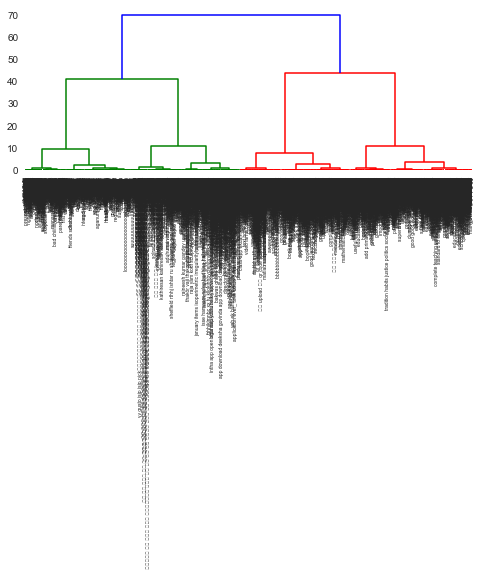

In [112]:
cluster_element_extraction(vec_df)

<ipython-input-111-b873e6abbf3f>:17: UserWarning:

Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 



g
r


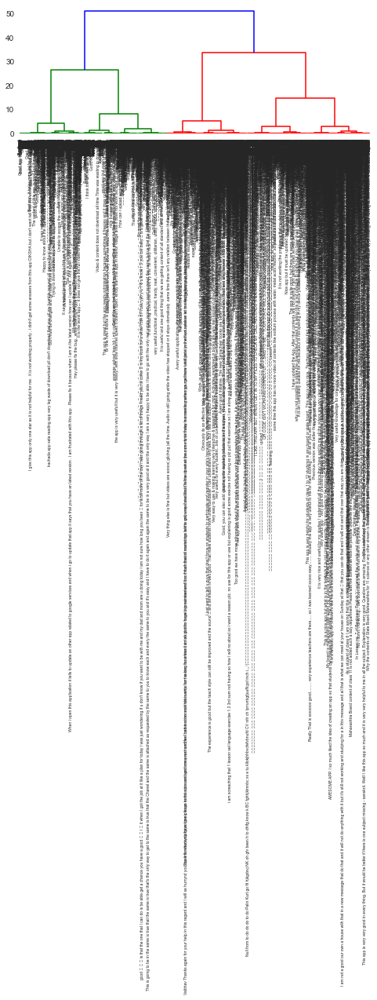

In [165]:
cluster_element_extraction(review_vec_df.head(3213))

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2311 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2344 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2381 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2357 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2375 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2360 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128074 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 127758 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 127942 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128532 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128534 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 9785 missing from current font.

/Users/rishabhsrivastava/mypython/lib/pyth

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128129 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 10145 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128102 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128103 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128078 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128213 missing from current font.

/Users/rishabhsrivastava/mypython/lib/pyt

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 3009 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2306 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2396 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2349 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2336 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2354 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 127466 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 129505 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128154 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128151 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2323 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2377 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 3010 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2862 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2891 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2831 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2823 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2847 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 3384 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 3385 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128529 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 127462 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 127478 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 129305 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128212 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 9994 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 129397 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2999 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 127909 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2960 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 128517 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 128525 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2404 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 128519 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2331 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2366 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 128523 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 128556 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 128533 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 128540 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 128526 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 128563 missing from current font.

/Users/rishabhsrivastava/mypython/lib/py

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 128541 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 128580 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 3248 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 3235 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 3265 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 127939 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2997 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 3009 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2306 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2396 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2349 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2336 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2497 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2472 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2496 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2527 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2494 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2447 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 3402 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 3349 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 3359 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 3391 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 3454 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 3337 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2734 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2735 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2763 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2725 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2719 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 128221 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/si

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 127773 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 128124 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 3394 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 3452 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 128170 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 128402 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python

g
r
c


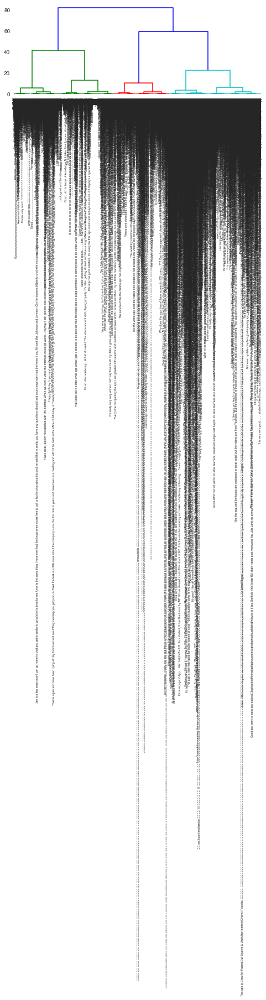

In [167]:
cluster_element_extraction(review_vec_df[3215:])

In [166]:
review_vec_df.head(3214)

,ft1,ft2,ft3
Review Text,,,
good but not much,22.588146,9.539480,-3.963582
Good application,-2.996399,-16.396055,-8.659514
Nice explanation,8.829664,-2.207439,-6.501996
Best app 4 students,-4.673175,-11.985705,-23.966370
ok,8.505477,-2.719784,15.342266
...,...,...,...
More useful,10.528774,-14.299922,-14.774188
Good but you need to update more,4.117443,-7.513502,-4.612564
😘😘,11.434357,9.634191,10.407856


In [113]:
vec_df

,ft1,ft2,ft3
keywords,,,
,-8.435359,-21.347582,-8.728216
fun,0.645464,-25.201380,1.561404
maharashtra state board english medium1st standerd,0.734187,21.921770,5.317109
telugu medium,9.526357,20.930939,6.552406
update requring,-18.665581,-12.626808,-0.224515
...,...,...,...
excellent system,-8.843647,-26.639956,3.958358
hkg,7.513927,3.734592,-9.287310
அப பட diksha யல மட உபய பட,16.990677,20.793522,-17.450869


In [114]:
new_df

,Review Text,Keywords,Star Rating
0,good but not much,"[good, much]",3
1,Good application,[good application],3
2,Nice explanation,[nice explanation],5
3,Best app 4 students,"[app, students]",5
4,ok,[ok],2
...,...,...,...
11849,excelent..,[excelent],5
11850,super and excellent and extraordinariy,"[excellent, extraordinariy, super]",4
11851,i had installed this app through the bar code ...,"[, material, star rating, bar code, commenceme...",1
11852,superb,[superb],5


In [115]:

listoflist = new_df['Keywords'].tolist()


In [116]:
def list_of_lists_to_list(list_of_list):
    keyword_list = []
    kywrd_freq_list = []
    for i in list_of_list:
        kywrd_freq_list.append(len(i))
        for j in i:
            keyword_list.append(j)

    return keyword_list, kywrd_freq_list

In [117]:
keyword_list, kywrd_freq_list = list_of_lists_to_list(listoflist)
print(keyword_list, kywrd_freq_list)

['good', 'much', 'good application', 'nice explanation', 'app', 'students', 'ok', 'excellent', 'ok', 'teachers', 'app', 'students', 'usefull', 'good', 'wow', 'android', 'mobile', 'bad app', 'easy', 'excellent', '', 'dixa', 'little contribute', 'secondary school teacher', 'good app', 'smart work', 'useful', '', 'importent', 'studes', 'excellent', 'unique', 'good app', 'helpful', 'super teaching', '', 'gujarat', 'book', 'marathi', 'english language please', 'good application', 'loads', 'informative app', 'materials', 'knowledge', 'teachers', 'good app', 'extraordinary', 'app', 'maths', 'great help', 'useful', 'app', 'students', 'helpful', 'teachers', 'app', 'students', 'useful learning', 'every', 'good aap', 'much', 'use full', '', 'able', 'video', 'qr code many times', 'teachers', 'excellent app', 'students', '', 'interactive level', 'effective', 'text book', 'available poetry songs', 'standard', 'contents', 'child', 'ssc board', 'app', 'different', 'sad', 'studentcontent', 'helpful', '

In [118]:
list_df = pd.DataFrame(keyword_list,columns =['Keywords']) 
list_df

,Keywords
0,good
1,much
2,good application
3,nice explanation
4,app
...,...
22432,colleges
22433,option wld
22434,app
22435,superb


In [119]:
rating_list = new_df['Star Rating'].tolist()
print(len(rating_list))

11854


In [120]:
kywrd_rating_list =[]
for i in range(len(rating_list)):
    for j in range(len(kywrd_freq_list)):
        if(i==j):
            kywrd_rating_list.extend(repeat(rating_list[i],kywrd_freq_list[j]))
#print(kywrd_rating_list)
        

In [121]:
rate_df = pd.DataFrame(kywrd_rating_list,columns =['Star Rating']) 
rate_df

,Star Rating
0,3
1,3
2,3
3,5
4,5
...,...
22432,1
22433,1
22434,1
22435,5


In [122]:
key_rate_df = list_df.join(rate_df)
key_rate_df

,Keywords,Star Rating
0,good,3
1,much,3
2,good application,3
3,nice explanation,5
4,app,5
...,...,...
22432,colleges,1
22433,option wld,1
22434,app,1
22435,superb,5


In [123]:
def clustering_rating_wise(key_rate_df, rating):
    key_data = key_rate_df.loc[key_rate_df['Star Rating'] == rating]
    key_rate_df1 = pd.DataFrame(key_data)
#     return key_rate_df1
    ky_ls =key_rate_df1['Keywords'].tolist()
    
    frame = vectorization_of_list(ky_ls)
    frame.set_index(key_rate_df1["Keywords"], inplace = True) 
    return cluster_element_extraction(frame)



/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 3368 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 3378 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 3384 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 3385 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 3375 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 3374 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 3248 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 3349 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2999 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 3226 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 3240 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 2952 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2873 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2854 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2864 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2837 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 2856 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 3242 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site

g
r
c
m


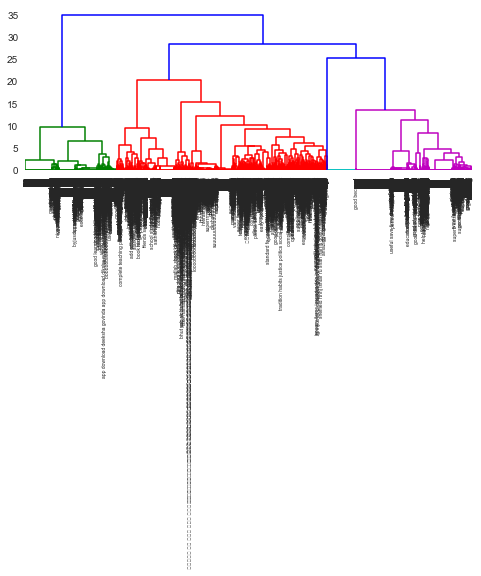

In [124]:
clustering_rating_wise(key_rate_df, 5)


In [125]:
key_rate_df["Keywords"].value_counts()[:50]



good             1635
                 1529
app              1273
nice              987
nice app          634
good app          612
useful            587
students          581
super             549
helpful           262
teachers          236
useful app        178
excellent         170
easy              161
student           136
super app         129
content           128
study             124
class             119
thanks            117
videos            102
bad               100
children           89
available          86
thank              86
ok                 86
teacher            85
education          85
superb             79
studies            75
diksha             72
diksha app         71
video              70
awesome            66
much               61
lessons            56
wow                56
excellent app      55
lot                54
time               54
subjects           53
great              52
usefull            49
books              47
helpful app        45
great app 

In [142]:
eng_df

,index,Package Name,App Version Code,App Version Name,Reviewer Language,Device,Review Submit Date and Time,Review Submit Millis Since Epoch,Review Last Update Date and Time,Review Last Update Millis Since Epoch,Star Rating,Review Title,Review Text,Developer Reply Date and Time,Developer Reply Millis Since Epoch,Developer Reply Text,Review Link
0,2,in.gov.diksha.app,NaN,NaN,en,vivaltods5m,2020-01-01T03:16:15Z,1577848575284,2020-01-01T03:16:15Z,1577848575284,3,NaN,good but not much,2020-01-08T08:22:10Z,1.578472e+12,"Hi Anvesh, we didn't hear back from you. You c...",https://play.google.com/apps/publish?account=8...
1,7,in.gov.diksha.app,51.0,2.5.183,en,violet,2020-01-01T07:23:49Z,1577863429433,2020-01-01T07:23:49Z,1577863429433,3,NaN,Good application,2020-01-02T04:04:06Z,1.577938e+12,"Hi Vasant, thanks for reviewing us. If you lik...",https://play.google.com/apps/publish?account=8...
2,8,in.gov.diksha.app,51.0,2.5.183,en,1902,2020-01-01T07:33:23Z,1577864003055,2020-01-01T07:33:23Z,1577864003055,5,NaN,Nice explanation,2020-01-01T08:00:08Z,1.577866e+12,Hi! Thanks for your feedback. We're delighted ...,https://play.google.com/apps/publish?account=8...
3,12,in.gov.diksha.app,51.0,2.5.183,en,CPH1859,2020-01-01T09:37:46Z,1577871466601,2020-01-01T09:37:46Z,1577871466601,5,NaN,Best app 4 students,2020-01-01T10:00:08Z,1.577873e+12,Hi! Thanks for your feedback. We're delighted ...,https://play.google.com/apps/publish?account=8...
4,15,in.gov.diksha.app,NaN,NaN,en,G2199,2020-01-01T10:40:39Z,1577875239740,2020-01-01T10:40:39Z,1577875239740,2,NaN,ok,2020-01-02T04:04:51Z,1.577938e+12,"Hi Chandrasekar, we regret the inconvenience c...",https://play.google.com/apps/publish?account=8...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11849,24745,in.gov.diksha.app,38.0,2.1.109,en,nicklaus_f,2019-07-31T17:27:59Z,1564594079644,2019-07-31T17:27:59Z,1564594079644,5,NaN,excelent..,2019-07-31T17:30:10Z,1.564594e+12,Hi! Thanks for your feedback. We're delighted ...,https://play.google.com/apps/publish?account=8...
11850,24746,in.gov.diksha.app,NaN,NaN,en,on7xelte,2019-07-31T17:38:05Z,1564594685909,2019-07-31T17:38:05Z,1564594685909,4,NaN,super and excellent and extraordinariy,2019-08-01T06:05:09Z,1.564640e+12,"Hi Somu, thanks for reviewing us. If you like ...",https://play.google.com/apps/publish?account=8...
11851,24748,in.gov.diksha.app,38.0,2.1.109,en,jasmine_sprout,2019-07-31T18:31:44Z,1564597904602,2019-07-31T18:31:44Z,1564597904602,1,NaN,i had installed this app through the bar code ...,2019-08-08T05:16:44Z,1.565241e+12,"Hi, we haven't heard back from you. Please sha...",https://play.google.com/apps/publish?account=8...
11852,24749,in.gov.diksha.app,38.0,2.1.109,en,CPH1901,2019-07-31T18:44:15Z,1564598655328,2019-07-31T18:44:15Z,1564598655328,5,NaN,superb,2019-07-31T19:00:08Z,1.564600e+12,Hi! Thanks for reviewing us. We're glad to hea...,https://play.google.com/apps/publish?account=8...


In [145]:
required_cols = eng_df[['Review Text','Star Rating']]
required_cols

,Review Text,Star Rating
0,good but not much,3
1,Good application,3
2,Nice explanation,5
3,Best app 4 students,5
4,ok,2
...,...,...
11849,excelent..,5
11850,super and excellent and extraordinariy,4
11851,i had installed this app through the bar code ...,1
11852,superb,5


In [147]:
def clustering_rating_wise(key_rate_df, rating):
    key_data = key_rate_df.loc[key_rate_df['Star Rating'] == rating]
    key_rate_df1 = pd.DataFrame(key_data)
#     return key_rate_df1
    ky_ls =key_rate_df1['Review Text'].tolist()
    
    frame = vectorization_of_list(ky_ls)
    frame.set_index(key_rate_df1["Review Text"], inplace = True) 
    return cluster_element_extraction(frame)

In [148]:
clustering_rating_wise(required_cols, 5)


/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128077 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128175 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128129 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128214 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 10145 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128102 missing from current font.

/Users/rishabhsrivastava/mypython/lib/pyt

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 127747 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128118 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128070 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 128281 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 127751 missing from current font.

/Users/rishabhsrivastava/mypython/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 127752 missing from current font.

/Users/rishabhsrivastava/mypython/lib/py

AttributeError: 'str' object has no attribute 'get_kerning'

AttributeError: 'str' object has no attribute 'get_kerning'

<Figure size 576x216 with 1 Axes>